## Capstone : Based on environmental stress data, can we build a model that predicts when a crop (pick crop) will go extinct in nature? 

### Roshini Sreenivas  | 2021-12-05 | Data Science, BrainStation

### Plan of attack: 
1. Brief description about the problem space, the why's and how's and from where's 
2. Load in the tools and packages we need to support our analysis 
3. Get data
4. Load in and read data
5. Data pre-processing and clean up
6. Basic EDA 
7. Feature Engineering
8. Baseline Model construction 
9. Time series Modeling  
10. Insights and Conclusions 

### Step 1 : The Problem

The end goal of this Capstone project is to be able to build a model that is able to predict crop extinction in nature based on environmental stress data. Its a form of an MVP (Minimum viable population) analysis. My hypothesis is that the Yield data will tend to zero at some point in the not too distant future, and that these parameters I have picked for demonstration purposes contribute towards that. 

I believe that if I succeed in building this model, it will be helpful to the agriculatural sector, in framing better policies around use of cropland or diversifying a species of crop. For the purposes of demonstration, I have opted to use three environmental stress parameters, as you will see below. At the end of the notebook, I will discuss insights and next steps and address my hypothesis and what I've discovered. 

A little further down, I will talk about the data I've collected and their sources. 

### Step 2 : Load in the tools we need

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

from scipy import stats
from scipy.stats import chisquare

from sklearn.model_selection import train_test_split

# To cross-validate
from sklearn.model_selection import cross_val_score

from sklearn.linear_model import LogisticRegression

from sklearn.preprocessing import OneHotEncoder

from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import StandardScaler

from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay

# Precision 
from sklearn.metrics import precision_score

# Recall
from sklearn.metrics import recall_score

from sklearn.metrics import f1_score

from sklearn.metrics import classification_report

# plotting
import plotly.express as px
from plotly.subplots import make_subplots
import plotly.graph_objs as go

# stats
from statsmodels.api import tsa # time series analysis
import statsmodels.api as sm

### Step 3 : Get Data 
There are 4 data sets that will, I believe, help me build a starter model. I've downloaded each of these data sets. My first task will be loading the data in, there are 4 csv files and then collating them into a final data set that I will be doing all of my analysis on. Let's load the four data sets. 
1. Crop data : <https://www.kaggle.com/raghavramasamy/crop-statistics-fao-all-countries> The crops data is a data set that looks at two production parameters (units and land in hectares) for all the countries that are member countries of the FAO (Food and Agriculture Organisation) from the year 1961 to 2019. 
2. Global surface temperature data : <https://www.kaggle.com/berkeleyearth/climate-change-earth-surface-temperature-data?ref=hackernoon.com> This is the average global temperature dataset, as granular as city level, runs from 1743-2013. 
3. Average sea level rise data : <https://www.kaggle.com/somesh24/sea-level-change> This is the average global sea level rise through the years 1800-2015. 
4. Air Quality data : <https://www.kaggle.com/yoannboyere/co2-ghg-emissionsdata> This dataset looks at air quality data from 1750-2017. 
5. Supplementary air-quality data : https://www.kaggle.com/unitednations/international-greenhouse-gas-emissions?ref=hackernoon.com I used only parts of this for comparison purposes. 

Let's break down what we hope to end up with in our dataset after merging them all together and we'll review if that is what we have later on in the notebook. 

**Year** : All the different datasets have different granularities for the date column. The challenge would be to decide what's a range that would suit for all the datasets so we can do a merge without losing any information. 

**Country** : These countries are all the ones that the FAO(Food and Agriculture Organisation) of the United Nations have on record as producers of agriculatural crops in the world.The FAO database is very well maintained. 

**Item** : This column is the names of all the crops ever produced in the world. 

**Area Harvested** : This is the total area the crop is grown on in a particular country in a particular year in hectares.

**Production** : Production is not an absolute value. Its in Kilograms. 

**Yield** : This is the target variable. It is the asbolute yield of the crop in units for a particular country for a particular year. 

**CO2_GHG** : This is the average emissions data in tonnes for a particular year and a particular country. 

**GMSL** : Average annual sea-level rise for a particular year. This is global. 

**AverageTemperature** : This is the soil temperature data for a particular country and a particular year. Its the yearly average, averaged from monthly data. 

### Step 4 : Read in the data sets 

#### Let's load in our base data set = crop data

In [2]:
df = pd.read_csv("Crops_AllData_Normalized.csv")

In [3]:
df.head()

,Area Code,Area,Item Code,Item,Element Code,Element,Year Code,Year,Unit,Value,Flag
0,2,Afghanistan,221,"Almonds, with shell",5312,Area harvested,1975,1975,ha,0.0,F
1,2,Afghanistan,221,"Almonds, with shell",5312,Area harvested,1976,1976,ha,5900.0,F
2,2,Afghanistan,221,"Almonds, with shell",5312,Area harvested,1977,1977,ha,6000.0,F
3,2,Afghanistan,221,"Almonds, with shell",5312,Area harvested,1978,1978,ha,6000.0,F
4,2,Afghanistan,221,"Almonds, with shell",5312,Area harvested,1979,1979,ha,6000.0,F


**We're going to do a basic clean up to get exactly what we want from this data frame before we go on and merge the other data sets to this in order to get our final dataset for the analysis**

All I want in my final table is Country, Item, Year, Production, Yield and Area harvested. 

In [4]:
def areas (s):
    if (s['Element'] == 'Area harvested'):
        return s['Value']
    else:
        return 0
df['Area Harvested'] = df.apply(areas, axis=1)

def production(s):
    if (s['Element'] == 'Production'):
        return s['Value']
    else:
        return 0
df['Production'] = df.apply(production, axis=1)

def yields(s):
    if (s['Element'] == 'Yield'):
        return s['Value']
    else:
        return 0
df['Yield'] = df.apply(yields, axis=1)

In [5]:
df2 = df.drop('Area Code', axis=1)
df2 = df2.drop('Item Code', axis=1)
df2 = df2.drop('Element Code', axis=1)
df2 = df2.drop('Year Code', axis=1)
df2 = df2.drop('Unit', axis=1)
df2 = df2.drop('Value', axis=1)
df2 = df2.drop('Flag', axis=1)
df2 = df2.drop('Element', axis=1)
df2.head()

,Area,Item,Year,Area Harvested,Production,Yield
0,Afghanistan,"Almonds, with shell",1975,0.0,0.0,0.0
1,Afghanistan,"Almonds, with shell",1976,5900.0,0.0,0.0
2,Afghanistan,"Almonds, with shell",1977,6000.0,0.0,0.0
3,Afghanistan,"Almonds, with shell",1978,6000.0,0.0,0.0
4,Afghanistan,"Almonds, with shell",1979,6000.0,0.0,0.0


In [6]:
crops = df2.groupby(['Year','Area', 'Item']).sum().reset_index()
crops.rename(columns = {'Area':'Country'}, inplace = True)
crops.head()

,Year,Country,Item,Area Harvested,Production,Yield
0,1961,Afghanistan,"Anise, badian, fennel, coriander",0.0,0.0,0.0
1,1961,Afghanistan,Apples,2220.0,15100.0,68018.0
2,1961,Afghanistan,Apricots,4820.0,32000.0,66390.0
3,1961,Afghanistan,Barley,350000.0,378000.0,10800.0
4,1961,Afghanistan,Berries nes,6800.0,60000.0,88235.0


**This table looks the way I want to to now. So I'm going to merge the other data sets into this one to build the final table on which we're going to build the model** 

### Step 5 : Merging the data sets, preprocessing and cleaning the data

#### a. Emissions Dataset merge
This was a bit convoluted to get done in the end. I have removed most of the work I did in this section. I had a supplementary dataset that I ultimately decided not to use that one, because this dataset is the more robust one. All I want from this data set is the year, country and emissions values.

In [7]:
df3 = pd.read_csv('co2_emission.csv')
df3.head()

,Entity,Code,Year,Annual CO₂ emissions (tonnes )
0,Afghanistan,AFG,1949,14656.0
1,Afghanistan,AFG,1950,84272.0
2,Afghanistan,AFG,1951,91600.0
3,Afghanistan,AFG,1952,91600.0
4,Afghanistan,AFG,1953,106256.0


In [8]:
df3.rename(columns = {'Entity':'Country'}, inplace = True)
df3.rename(columns = {'Annual CO₂ emissions (tonnes )':'CO2_GHG'}, inplace = True)
emissions = df3.drop('Code', axis=1)
emissions.head()

,Country,Year,CO2_GHG
0,Afghanistan,1949,14656.0
1,Afghanistan,1950,84272.0
2,Afghanistan,1951,91600.0
3,Afghanistan,1952,91600.0
4,Afghanistan,1953,106256.0


In [9]:
emissions[emissions['Country'] == 'China']

,Country,Year,CO2_GHG
4231,China,1751,0.000000e+00
4232,China,1752,0.000000e+00
4233,China,1753,0.000000e+00
4234,China,1754,0.000000e+00
4235,China,1755,0.000000e+00
...,...,...,...
4480,China,2013,9.796527e+09
4481,China,2014,9.820360e+09
4482,China,2015,9.716468e+09
4483,China,2016,9.704479e+09


So, I happen to know that some of the countries are named differently in the emissions database and the crops database even though they are the same country because I did a lot of work on this before I discovered this. 

One of the challenges I had initially was how to merge all these without losing any information. During that process, I merged it incorrectly and then had nulls further down. So I built a linear regression model to try and impute the missing values based on a simple equation between year and emissions, but it wasn't a linear relationship. So I tried exponentials and polynomials, but in the process of learning my data a bit better I discovered this thing about the naming of the countries.

So I re-did the merge and now I have no null values at all for the emissions dataset. 

All of this workflow has been removed from this notebook. 

So, now, since I know this issue already, let's rename the countries before we check for nans so it actually captures all the available emissions for the countries. 

In [10]:
emissions["Country"].replace({"Cote d'Ivoire": "C�te d'Ivoire", "China": "China, mainland", 
                             "Laos":"Lao People's Democratic Republic","Bolivia": "Bolivia (Plurinational State of)",
                             "Swaziland":"Eswatini", "Cape Verde":"Cabo Verde", 
                             "Democratic Republic of Republic of the Congo": "Democratic Republic of the Congo",
                             "Republic of the Congo":"Congo","Brunei":"Brunei Darussalam",
                             "French Guiana":"French Guyana","Iran":"Iran (Islamic Republic of)",
                             "Ethiopia":"Ethiopia PDR", }, inplace=True)

In [11]:
emissions[(emissions['Year']>=1899) & (emissions['Country']=='China, mainland')]

,Country,Year,CO2_GHG
4368,"China, mainland",1899,9.526400e+04
4369,"China, mainland",1902,9.526400e+04
4370,"China, mainland",1903,1.963904e+06
4371,"China, mainland",1904,2.088480e+06
4372,"China, mainland",1905,2.297328e+06
...,...,...,...
4480,"China, mainland",2013,9.796527e+09
4481,"China, mainland",2014,9.820360e+09
4482,"China, mainland",2015,9.716468e+09
4483,"China, mainland",2016,9.704479e+09


Now we're good to merge this into the crops dataset we have prepared already.

In [12]:
merge1 = pd.merge(crops, emissions,
                 on=["Year", "Country"])
merge1.head()


,Year,Country,Item,Area Harvested,Production,Yield,CO2_GHG
0,1961,Afghanistan,"Anise, badian, fennel, coriander",0.0,0.0,0.0,490797.7
1,1961,Afghanistan,Apples,2220.0,15100.0,68018.0,490797.7
2,1961,Afghanistan,Apricots,4820.0,32000.0,66390.0,490797.7
3,1961,Afghanistan,Barley,350000.0,378000.0,10800.0,490797.7
4,1961,Afghanistan,Berries nes,6800.0,60000.0,88235.0,490797.7


In [13]:
merge1.isna().sum()

Year              0
Country           0
Item              0
Area Harvested    0
Production        0
Yield             0
CO2_GHG           0
dtype: int64

What we've done is, we've renamed the columns on the second dataset to match the first and merged them using year and country columns.

**Perfect. We can see that the additional column has been added. And the merge1.head() function shows us what the table looks like right now, and it is what I want. So onwards.** We will now merge the third dataset (sea-level data) to the original table. 

#### b. Sea Level dataset merge 
We will now merge the sea level rise data set into our original dataset. 

In [14]:
df4 = pd.read_csv('sea_levels_2015.csv')
df4.head()

,Time,GMSL,GMSL uncertainty
0,1880-01-15,-183.0,24.2
1,1880-02-15,-171.1,24.2
2,1880-03-15,-164.3,24.2
3,1880-04-15,-158.2,24.2
4,1880-05-15,-158.7,24.2


All I need from here is the year and the sealevel because this is a global average. 

In [15]:
df4.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1608 entries, 0 to 1607
Data columns (total 3 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   Time              1608 non-null   object 
 1   GMSL              1608 non-null   float64
 2   GMSL uncertainty  1608 non-null   float64
dtypes: float64(2), object(1)
memory usage: 37.8+ KB


In [16]:
df4['Time'] = pd.to_datetime(df4['Time'])
df4['Year'] = pd.DatetimeIndex(df4['Time']).year
df4.head()

,Time,GMSL,GMSL uncertainty,Year
0,1880-01-15,-183.0,24.2,1880
1,1880-02-15,-171.1,24.2,1880
2,1880-03-15,-164.3,24.2,1880
3,1880-04-15,-158.2,24.2,1880
4,1880-05-15,-158.7,24.2,1880


In [17]:
df5 = df4.drop('Time', axis=1)
df5 = df5.drop('GMSL uncertainty', axis=1)
df5.head()

,GMSL,Year
0,-183.0,1880
1,-171.1,1880
2,-164.3,1880
3,-158.2,1880
4,-158.7,1880


In [18]:
sealvl = df5.groupby(['Year']).mean().reset_index()
sealvl.head()

,Year,GMSL
0,1880,-158.725000
1,1881,-153.058333
2,1882,-169.883333
3,1883,-164.591667
4,1884,-143.750000


So we've already put together the table for the merge. We have the sealevel and then we have the year. We'll merge on the year. 

In [19]:
merge2 = pd.merge(merge1, sealvl,
                on=["Year"])
merge2.head()

,Year,Country,Item,Area Harvested,Production,Yield,CO2_GHG,GMSL
0,1961,Afghanistan,"Anise, badian, fennel, coriander",0.0,0.0,0.0,490797.7,-38.091667
1,1961,Afghanistan,Apples,2220.0,15100.0,68018.0,490797.7,-38.091667
2,1961,Afghanistan,Apricots,4820.0,32000.0,66390.0,490797.7,-38.091667
3,1961,Afghanistan,Barley,350000.0,378000.0,10800.0,490797.7,-38.091667
4,1961,Afghanistan,Berries nes,6800.0,60000.0,88235.0,490797.7,-38.091667


We have now merged three of our four data sets into one original dataset upon which I will do my analyses. 

In [20]:
merge2.isna().sum()

Year              0
Country           0
Item              0
Area Harvested    0
Production        0
Yield             0
CO2_GHG           0
GMSL              0
dtype: int64

A final sanity check shows us that we now have 8 columns in our dataframe, and no nulls yet. Pefect. Moving on to the last dataset to merge. 

#### d. Temperature data sets

**We're going to now merge global temperature data organised by country and year to this table and then we will start our explarotary data analysis.** 

We will now

In [21]:
df6 = pd.read_csv('GlobalLandTemperaturesByCountry.csv')
df6.head()

,dt,AverageTemperature,AverageTemperatureUncertainty,Country
0,1743-11-01,4.384,2.294,Åland
1,1743-12-01,NaN,NaN,Åland
2,1744-01-01,NaN,NaN,Åland
3,1744-02-01,NaN,NaN,Åland
4,1744-03-01,NaN,NaN,Åland


In [22]:
df6.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 577462 entries, 0 to 577461
Data columns (total 4 columns):
 #   Column                         Non-Null Count   Dtype  
---  ------                         --------------   -----  
 0   dt                             577462 non-null  object 
 1   AverageTemperature             544811 non-null  float64
 2   AverageTemperatureUncertainty  545550 non-null  float64
 3   Country                        577462 non-null  object 
dtypes: float64(2), object(2)
memory usage: 17.6+ MB


Let's prepare this for a merge

In [23]:
temp = df6.groupby(['dt','Country']).sum().reset_index()
temp.head()

,dt,Country,AverageTemperature,AverageTemperatureUncertainty
0,1743-11-01,Albania,8.620,2.268
1,1743-11-01,Andorra,7.556,2.188
2,1743-11-01,Austria,2.482,2.116
3,1743-11-01,Belarus,0.767,2.465
4,1743-11-01,Belgium,7.106,1.855


In [24]:
temp['dt'] = pd.to_datetime(temp['dt'])
# then group by year, and get the mean:
temp.groupby(pd.Grouper(key='dt', freq='Y')).mean().dropna()

,AverageTemperature,AverageTemperatureUncertainty
dt,,
1743-12-31,2.592070,1.091760
1744-12-31,6.558598,1.424202
1745-12-31,0.462375,0.653530
1746-12-31,0.000000,0.000000
1747-12-31,0.000000,0.000000
...,...,...
2009-12-31,19.465948,0.349424
2010-12-31,19.549025,0.346237
2011-12-31,19.375974,0.363759


In [25]:
df7 = temp.drop(['AverageTemperatureUncertainty'], axis=1)
df7.head()

,dt,Country,AverageTemperature
0,1743-11-01,Albania,8.620
1,1743-11-01,Andorra,7.556
2,1743-11-01,Austria,2.482
3,1743-11-01,Belarus,0.767
4,1743-11-01,Belgium,7.106


In [26]:
df7['Year'] = pd.DatetimeIndex(df7['dt']).year

In [27]:
df7.head()

,dt,Country,AverageTemperature,Year
0,1743-11-01,Albania,8.620,1743
1,1743-11-01,Andorra,7.556,1743
2,1743-11-01,Austria,2.482,1743
3,1743-11-01,Belarus,0.767,1743
4,1743-11-01,Belgium,7.106,1743


In [28]:
df8 = df7.drop(['dt'], axis=1)
df8.head()

,Country,AverageTemperature,Year
0,Albania,8.620,1743
1,Andorra,7.556,1743
2,Austria,2.482,1743
3,Belarus,0.767,1743
4,Belgium,7.106,1743


In [29]:
df8[(df8['Year']==1961) & (df8['Country']=='Algeria')]

,Country,AverageTemperature,Year
423646,Algeria,11.106,1961
423889,Algeria,14.798,1961
424132,Algeria,17.525,1961
424375,Algeria,23.683,1961
424618,Algeria,28.835,1961
424861,Algeria,31.316,1961
425104,Algeria,33.772,1961
425347,Algeria,32.682,1961
425590,Algeria,29.680,1961
425833,Algeria,23.877,1961


Now we have 12 values, so find mean of that for the year for a particular country.

In [30]:
temp_2 = df8.groupby(['Year','Country']).mean().reset_index()
temp_2.head()

,Year,Country,AverageTemperature
0,1743,Albania,4.3100
1,1743,Andorra,3.7780
2,1743,Austria,1.2410
3,1743,Belarus,0.3835
4,1743,Belgium,3.5530


In [31]:
temp_2[(temp_2['Year']==1961) & (temp_2['Country']=='Algeria')]

,Year,Country,AverageTemperature
35367,1961,Algeria,23.390333


And now we're ready for the final merge.

In [32]:
temp_2.reset_index(drop=True, inplace=True)
merge2.reset_index(drop=True, inplace=True)

In [33]:
df_final= pd.merge(merge2, temp_2,
                         on=["Year", "Country"])
df_final.head()

,Year,Country,Item,Area Harvested,Production,Yield,CO2_GHG,GMSL,AverageTemperature
0,1961,Afghanistan,"Anise, badian, fennel, coriander",0.0,0.0,0.0,490797.7,-38.091667,14.064917
1,1961,Afghanistan,Apples,2220.0,15100.0,68018.0,490797.7,-38.091667,14.064917
2,1961,Afghanistan,Apricots,4820.0,32000.0,66390.0,490797.7,-38.091667,14.064917
3,1961,Afghanistan,Barley,350000.0,378000.0,10800.0,490797.7,-38.091667,14.064917
4,1961,Afghanistan,Berries nes,6800.0,60000.0,88235.0,490797.7,-38.091667,14.064917


**Excellent. Okay, looks like we're in pretty decent shape for a bird's eye view. We've merged all our tables together based on the year and country columns. And now we're ready to start analysis of our data set.**

### Step 6 : Basic EDA 

Now, I would like this data to only reflect the data between the years 1961 and 2013. Let's ensure that this time period is uniform across the table. 

I would like to drop 2014-2019 because the temperature data I have doesn't run all the way to that point and my sea_level data, so it will only have Nan values from 2014 on.  

In [34]:
df_final.drop(df_final[df_final.Year > 2013].index, inplace=True)

Let's check what has happened. 

In [35]:
df_final["Year"].unique()

array([1961, 1962, 1963, 1964, 1965, 1966, 1967, 1968, 1969, 1970, 1971,
       1972, 1973, 1974, 1975, 1976, 1977, 1978, 1979, 1980, 1981, 1982,
       1983, 1984, 1985, 1986, 1987, 1988, 1989, 1990, 1991, 1992, 1993,
       1994, 1995, 1996, 1997, 1998, 1999, 2000, 2001, 2002, 2003, 2004,
       2005, 2006, 2007, 2008, 2009, 2010, 2011, 2012, 2013], dtype=int64)

Perfect. Looks like we've gotten where we need to go! Moving on. 

In [36]:
#Shape 
df_final.shape

(440737, 9)

In [37]:
df_final.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 440737 entries, 0 to 440736
Data columns (total 9 columns):
 #   Column              Non-Null Count   Dtype  
---  ------              --------------   -----  
 0   Year                440737 non-null  int64  
 1   Country             440737 non-null  object 
 2   Item                440737 non-null  object 
 3   Area Harvested      440737 non-null  float64
 4   Production          440737 non-null  float64
 5   Yield               440737 non-null  float64
 6   CO2_GHG             440737 non-null  float64
 7   GMSL                440737 non-null  float64
 8   AverageTemperature  440737 non-null  float64
dtypes: float64(6), int64(1), object(2)
memory usage: 49.8+ MB


**Looks okay, so far. Only country name and item name are non-numeric columns.**

Let's check for duplicates first. 

####  DUPLICATES : ROWS 

In [38]:
df_final.duplicated().sum()

0

**Okay, I think at this point, the most efficient way to do this would be to pick a fruit. And then build the model for it and see if it works across the board a little later. We already know bananas are in real danger, so let's pull out the data only for bananas.**

### Reducing the dataset - Bananas

In [39]:
df_banana = df_final[df_final.Item == 'Bananas']
df_banana

,Year,Country,Item,Area Harvested,Production,Yield,CO2_GHG,GMSL,AverageTemperature
53,1961,Africa,Bananas,530320.0,3204079.0,60418.0,1.619943e+08,-38.091667,24.028500
275,1961,Algeria,Bananas,0.0,0.0,0.0,6.055917e+06,-38.091667,23.390333
333,1961,Angola,Bananas,20000.0,175000.0,87500.0,4.537120e+05,-38.091667,21.938750
384,1961,Argentina,Bananas,480.0,11649.0,242688.0,5.112671e+07,-38.091667,14.972917
471,1961,Australia,Bananas,10353.0,123863.0,119640.0,9.050390e+07,-38.091667,21.964250
...,...,...,...,...,...,...,...,...,...
440202,2013,Uganda,Bananas,131489.0,563357.0,42844.0,4.645220e+06,67.725000,21.355222
440346,2013,United Arab Emirates,Bananas,11.0,191.0,173636.0,1.682110e+08,67.725000,26.107222
440531,2013,Yemen,Bananas,10060.0,126332.0,125579.0,2.498041e+07,67.725000,25.004222
440598,2013,Zambia,Bananas,160.0,680.0,42500.0,3.756145e+06,67.725000,18.840889


OKay, so this is what we have to work with. Let's run it through all the check points again. 

### SHAPE

In [40]:
df_banana.shape

(4902, 9)

In [41]:
df_banana.head()

,Year,Country,Item,Area Harvested,Production,Yield,CO2_GHG,GMSL,AverageTemperature
53,1961,Africa,Bananas,530320.0,3204079.0,60418.0,1.619943e+08,-38.091667,24.028500
275,1961,Algeria,Bananas,0.0,0.0,0.0,6.055917e+06,-38.091667,23.390333
333,1961,Angola,Bananas,20000.0,175000.0,87500.0,4.537120e+05,-38.091667,21.938750
384,1961,Argentina,Bananas,480.0,11649.0,242688.0,5.112671e+07,-38.091667,14.972917
471,1961,Australia,Bananas,10353.0,123863.0,119640.0,9.050390e+07,-38.091667,21.964250


In [42]:
df_banana.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 4902 entries, 53 to 440655
Data columns (total 9 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   Year                4902 non-null   int64  
 1   Country             4902 non-null   object 
 2   Item                4902 non-null   object 
 3   Area Harvested      4902 non-null   float64
 4   Production          4902 non-null   float64
 5   Yield               4902 non-null   float64
 6   CO2_GHG             4902 non-null   float64
 7   GMSL                4902 non-null   float64
 8   AverageTemperature  4902 non-null   float64
dtypes: float64(6), int64(1), object(2)
memory usage: 383.0+ KB


### DUPLICATE ROWS

In [43]:
df_banana.duplicated().sum()

0

There aren't any! Perfect merge!There were before. But that part of the workflow as also been removed, because it is now irrelevant. We'll just make a copy of the dataframe now so I have an original to come back to in case I want to work with that dataset.

In [44]:
df2_banana = df_banana.drop_duplicates().copy()

In [45]:
df2_banana.shape

(4902, 9)

In [46]:
df2_banana.duplicated().sum()

0

Okay, this looks good. Let's check for duplicate columns. 

### DUPLICATE COLUMNS 

In [47]:
df2_banana.T.duplicated()

Year                  False
Country               False
Item                  False
Area Harvested        False
Production            False
Yield                 False
CO2_GHG               False
GMSL                  False
AverageTemperature    False
dtype: bool

Now this is great. I know for a fact that none of the columns are duplicates of the other so we're keeping them all. 

Alright, looks okay so far. Let's move on to the Nans. 

### NANs

In [48]:
#check for Nans
df2_banana.isna().sum()

Year                  0
Country               0
Item                  0
Area Harvested        0
Production            0
Yield                 0
CO2_GHG               0
GMSL                  0
AverageTemperature    0
dtype: int64

Initially, I did have nans. I had nans in emissions which I've explained how I dealt with. And I had nans in temperature that I imputed with the central tendency median. But none of that is relevant after I fixed the merge. There aren't anymore nans so, that part of the workflow has also been removed. 

**Okay. We've finally landed on the data set that we're going to be working with and building our model on.** 

In [49]:
df2_banana.head()

,Year,Country,Item,Area Harvested,Production,Yield,CO2_GHG,GMSL,AverageTemperature
53,1961,Africa,Bananas,530320.0,3204079.0,60418.0,1.619943e+08,-38.091667,24.028500
275,1961,Algeria,Bananas,0.0,0.0,0.0,6.055917e+06,-38.091667,23.390333
333,1961,Angola,Bananas,20000.0,175000.0,87500.0,4.537120e+05,-38.091667,21.938750
384,1961,Argentina,Bananas,480.0,11649.0,242688.0,5.112671e+07,-38.091667,14.972917
471,1961,Australia,Bananas,10353.0,123863.0,119640.0,9.050390e+07,-38.091667,21.964250


Let's break down what our different columns in our final dataset mean before we go further. We've actually gotten to the point where we had hoped to be.

**Year** : The range is between 1961-2013. I decided this time range is what works best for all the different datasets I'm working with. 

**Country** : Since we've actually pulled out Bananas, these countries are all the ones that the FAO(Food and Agriculture Organisation) of the United Nations have on record as producers of banana in the world. But in the original dataframe, this was all the countries that produced all the different crops in the world. The FAO database is very robust. 

**Item** : Right now, we only have bananas. So this column will be dropped. But as mentioned before, generally this column is all the crops produced in the world. 

**Area Harvested** : This is the total area the crop is grown on in a particular country in a particular year in hectares.

**Production** : Production is not an absolute value. Its in Kilograms. 

**Yield** : This is the target variable. It is the asbolute yield of the crop in units for a particular country for a particular year. 

**CO2_GHG** : This is the average emissions data in tonnes for a particular year and a particular country. 

**GMSL** : Average annual sea-level rise for a particular year. This is global. 

**AverageTemperature** : This is the soil temperature data for a particular country and a particular year. Its the yearly average, averaged from monthly data. 

Let's do some hypothesis testing and understand the relationship between our different numeric variables. 

### Relationship between variables 

In [50]:
#build a co-relatio matrix
corrMatrix = df2_banana.corr()
print (corrMatrix)

                        Year  Area Harvested  Production     Yield   CO2_GHG  \
Year                1.000000        0.084004    0.139162  0.165106  0.164236   
Area Harvested      0.084004        1.000000    0.816726 -0.026369  0.509656   
Production          0.139162        0.816726    1.000000  0.149118  0.611246   
Yield               0.165106       -0.026369    0.149118  1.000000  0.094396   
CO2_GHG             0.164236        0.509656    0.611246  0.094396  1.000000   
GMSL                0.972453        0.083096    0.143580  0.162751  0.163543   
AverageTemperature  0.051665        0.043017    0.051801 -0.015870 -0.317086   

                        GMSL  AverageTemperature  
Year                0.972453            0.051665  
Area Harvested      0.083096            0.043017  
Production          0.143580            0.051801  
Yield               0.162751           -0.015870  
CO2_GHG             0.163543           -0.317086  
GMSL                1.000000            0.046453  
Av

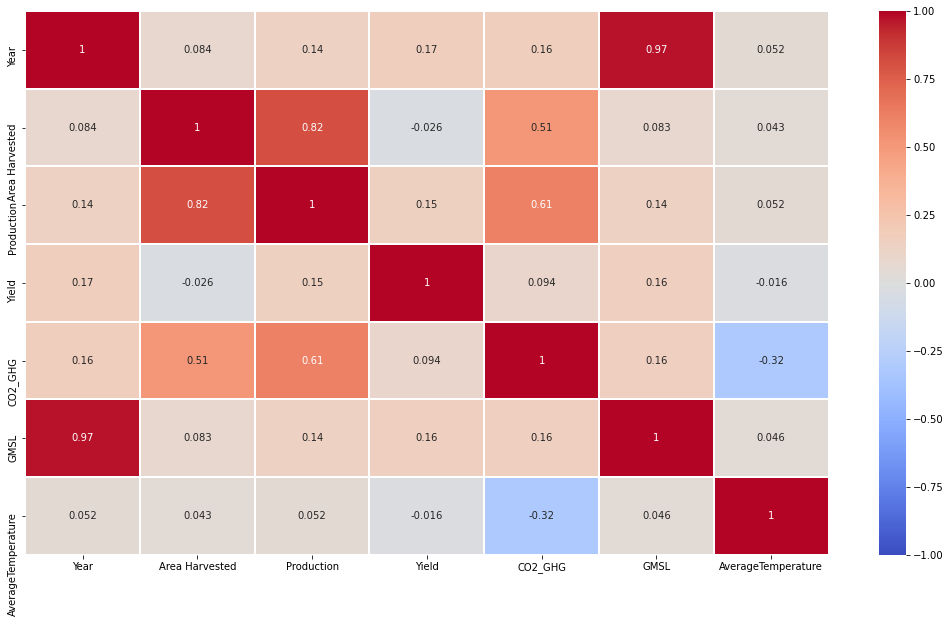

In [51]:
#plot it
plt.figure(figsize=(18,10))
sns.heatmap(df2_banana.corr(), cmap='coolwarm', vmin=-1, vmax=1, annot=True, lw=1)
plt.show()

We can see from the co-relation matrix, that some elements are better co-related than others. Let's examine these a bit more closely. 

- Sea level rise and year have a very strong co-relation. This is evident from the line plot below as well. 
- Year seems to have some kind of relationship with every variable, thought its most strongly co-related to sea level.
- Area Harvested and Production have a strong co-relation but neither seem to have a relationship with Yield. 
- Our target variable Yield does not look to be strongly connected to any of our independant variables. 


In [52]:
X = df2_banana[df2_banana.columns[:-1]]
y = df2_banana['Yield']

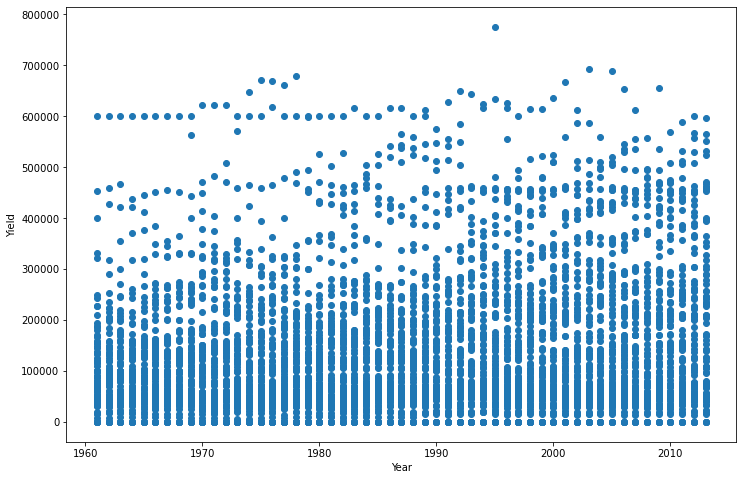

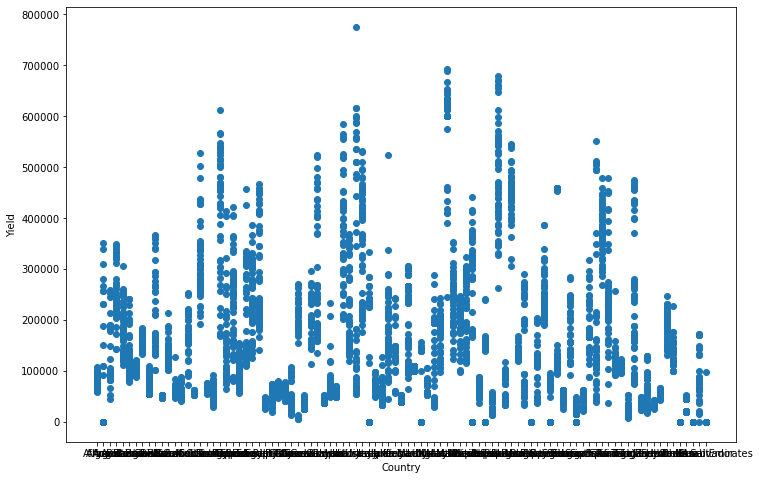

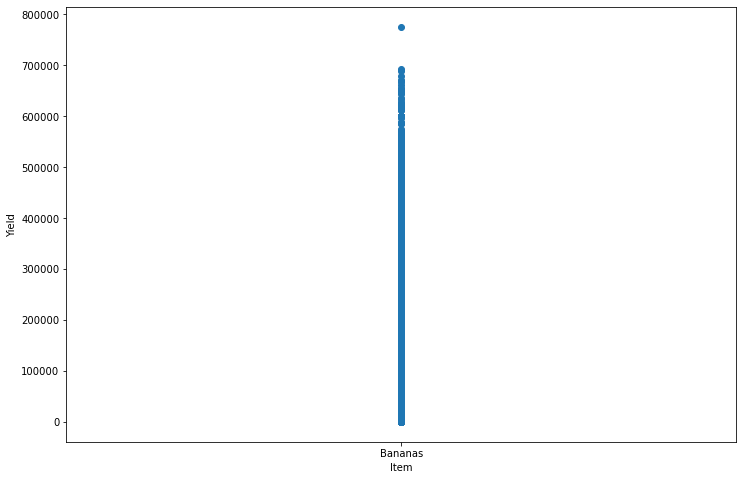

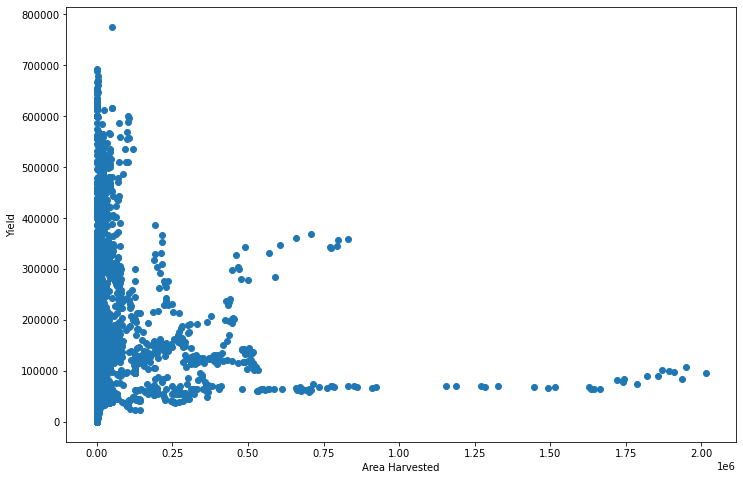

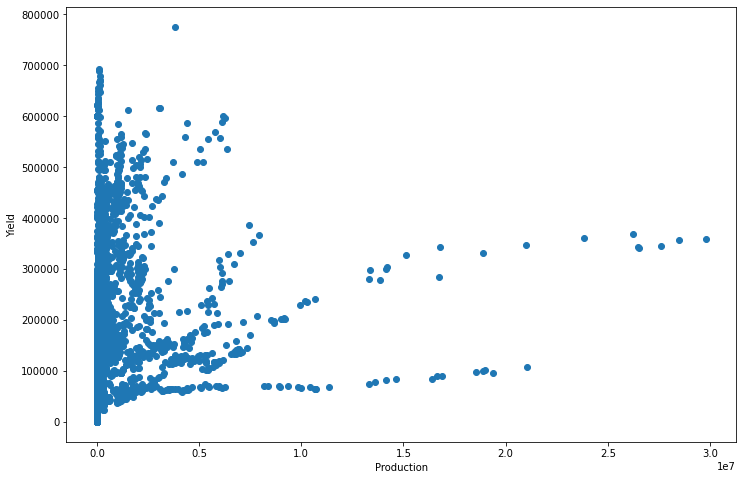

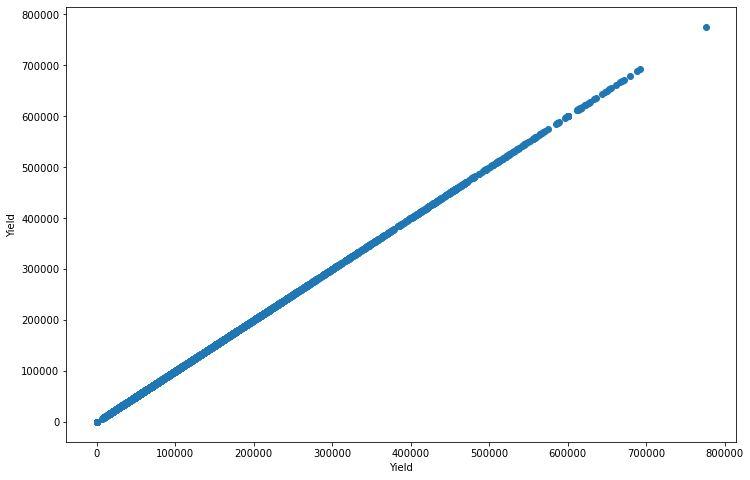

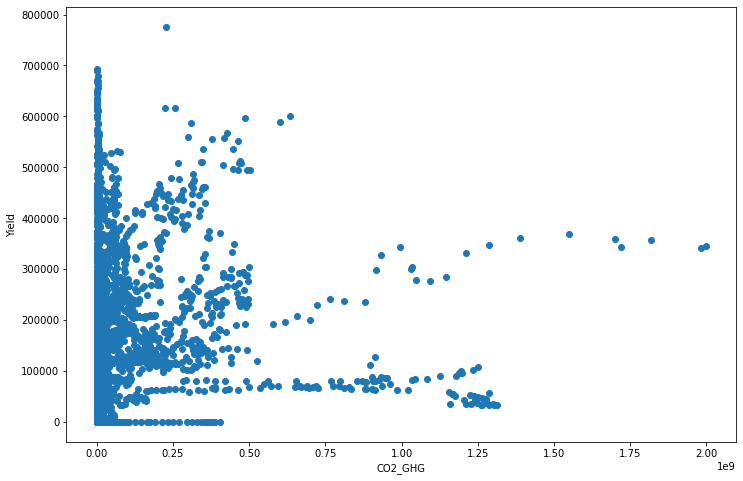

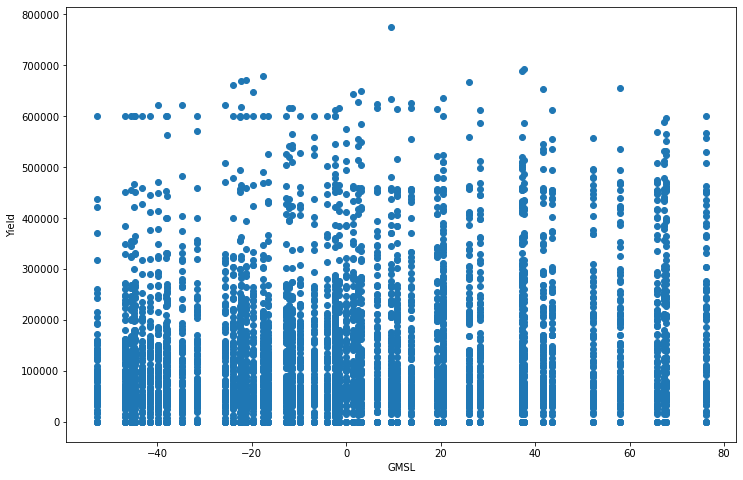

In [53]:
#Let's make scatter plots to explore the relationships of various columns to yield
for col in X.columns: 
    plt.figure(figsize = (12,8))
    plt.scatter(X[col], y)
    plt.ylabel('Yield')
    plt.xlabel(col)
    plt.show();

We're going to use Pearson's ratio to analyse the ones that I can see from the co-relation matrix and the scatter plots might have a decent co-relation and a vaguely linear relationship with our target variable.

In [54]:
#Assigning the variables
X = df2_banana['Yield']
y = df2_banana['Area Harvested']
stats.pearsonr (X, y)

(-0.026369349939935297, 0.06488040057597834)

As mentioned before, area harvested and yield are not sigificantly co-related, p>0.05.

In [55]:
X = df2_banana['Yield']
y2 = df2_banana['CO2_GHG']
stats.pearsonr (X, y2)

(0.09439613421888607, 3.539324826218211e-11)

p<0.05, this is heartening to see! Emissions do have a statistically significant relationship to Yield. 

In [56]:
X = df2_banana['Yield']
y3 = df2_banana['GMSL']
stats.pearsonr (X, y3)

(0.16275068514701777, 1.8990734043337107e-30)

And so does sea level rise, p<0.05, so statistically significant. 

In [57]:
X = df2_banana['Yield']
y4 = df2_banana['AverageTemperature']
stats.pearsonr (X, y4)

(-0.015870044757268397, 0.2666043311060856)

Soil temperature seems to have no impact on yield at all. That does make sense too. In retrospect, its not a metric I would pick if I could redo the whole project. 

In [58]:
X = df2_banana['Yield']
y5 = df2_banana['Production']
stats.pearsonr (X, y5)

(0.14911829565495438, 8.965878997313576e-26)

Yield seems to have a stronger relationship with production than with area harvested. Which is not strange, this is what we do expect to see because production and yield is sort of the same thing in different units.  

Let's check the distributions too. 

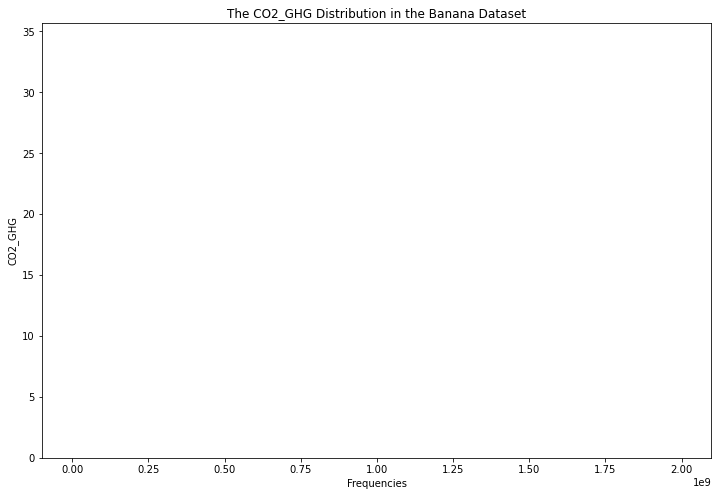

3.664000e+03    34
2.931200e+04    33
4.763200e+04    32
2.564800e+04    27
7.328000e+03    26
                ..
3.036573e+06     1
5.495890e+06     1
1.262639e+09     1
3.401061e+06     1
6.724544e+06     1
Name: CO2_GHG, Length: 3892, dtype: int64


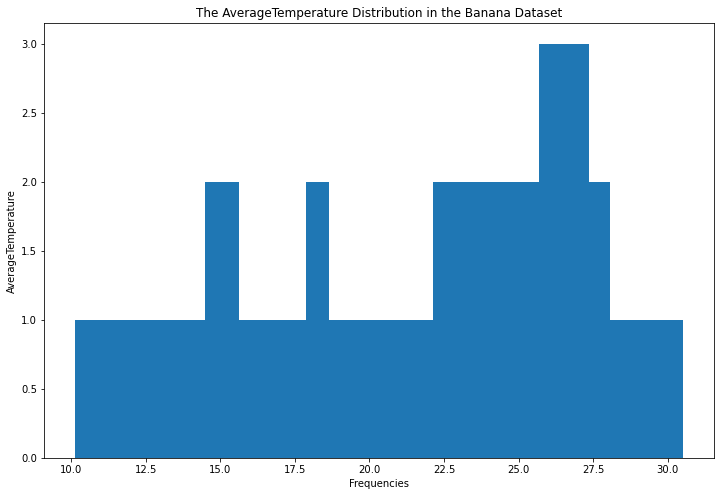

26.087500    3
26.624500    3
26.133500    3
26.974333    3
26.603917    3
            ..
21.768083    1
24.609000    1
27.497250    1
22.901833    1
12.833833    1
Name: AverageTemperature, Length: 4801, dtype: int64


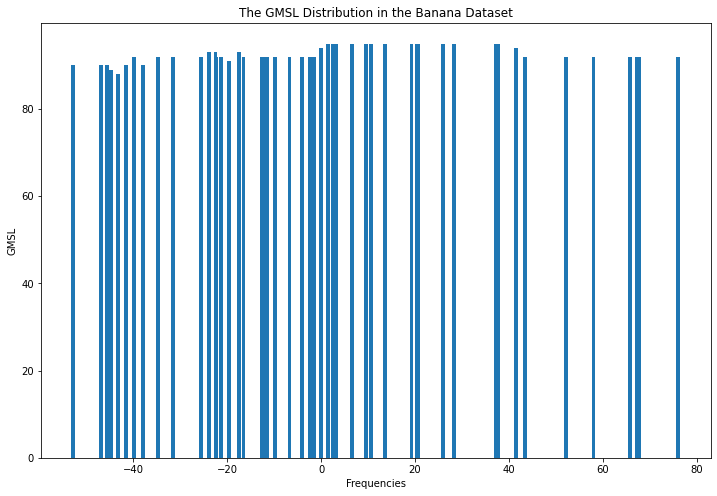

 10.666667    95
 37.183333    95
 6.575000     95
 25.983333    95
 20.483333    95
 1.416667     95
 19.225000    95
 28.358333    95
 20.558333    95
 2.508333     95
 3.166667     95
 13.666667    95
 9.525000     95
 37.608333    95
 37.291667    94
 41.566667    94
 0.008333     94
-17.566667    93
-23.966667    93
-22.533333    93
-1.466667     92
 67.300000    92
 76.083333    92
-21.275000    92
-2.391667     92
-39.941667    92
 65.750000    92
-16.525000    92
 43.483333    92
 52.200000    92
-11.458333    92
-6.758333     92
 58.016667    92
 67.725000    92
-4.075000     92
-22.350000    92
-12.683333    92
-25.591667    92
-12.058333    92
-34.725000    92
-9.858333     92
-31.591667    92
-2.316667     92
-19.716667    91
-46.966667    90
-52.825000    90
-38.000000    90
-45.608333    90
-41.541667    90
-44.925000    89
-44.808333    89
-38.091667    88
-43.316667    88
Name: GMSL, dtype: int64


In [59]:
columns = ['CO2_GHG', 'AverageTemperature', 'GMSL']


for col in columns:

    plt.figure(figsize=(12,8))
    plt.bar(df2_banana[col].value_counts().index, df2_banana[col].value_counts().values)
    plt.xlabel("Frequencies")
    plt.ylabel(col)
    plt.title(f"The {col} Distribution in the Banana Dataset")
    plt.show()
    
    print(df2_banana[col].value_counts())

None of the columns have a normal distribution, so ANOVA does not work here. Chi squared tests don't work either because I do have negative values in some columns. So we'll just leave it here and try to make lm plots very to explore the realtionships between the independant variables. 

C:\Users\The PRO\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


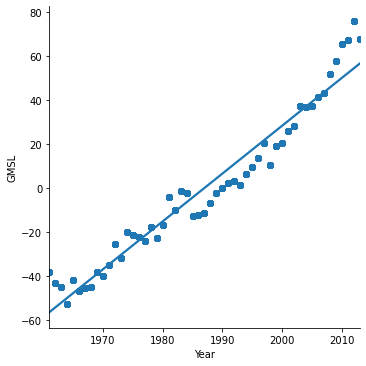

In [60]:
sns.lmplot('Year', 'GMSL', data=df2_banana)

C:\Users\The PRO\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


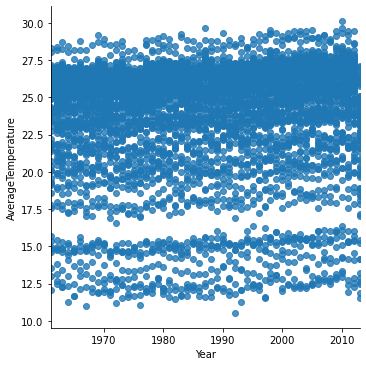

In [61]:
sns.lmplot('Year', 'AverageTemperature', data=df2_banana)

C:\Users\The PRO\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


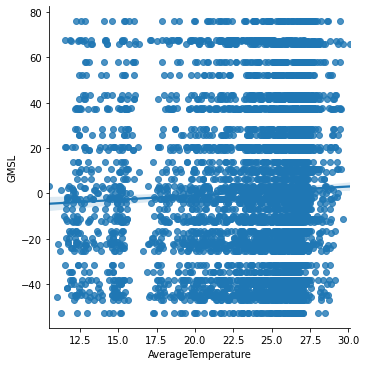

In [62]:
sns.lmplot('AverageTemperature', 'GMSL', data=df2_banana)

C:\Users\The PRO\anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


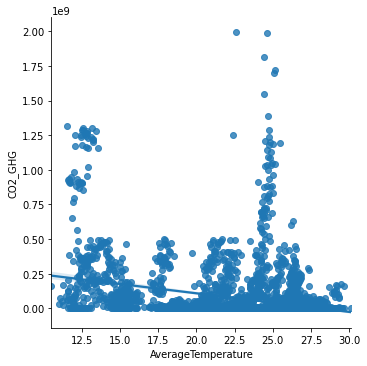

In [63]:
sns.lmplot('AverageTemperature', 'CO2_GHG', data=df2_banana)

Summarising the plots, only sea level seems linearly related to year. Some others like emissions and year have vaguely linear relationships, so I can perhaps make an educate guess that its exponentially related to the year. There doesn't seem any significance to the relationships between any other variables.  

In [64]:
#Let's pull this file out so I can work with Tableau 
df2_banana.to_csv('df2_banana-cleaned.csv', index=False)

 **Basic EDA visuals : Most of the work was done in Tableau. The tableau workbook will be added to submission documents.**

But let's import some interesting visuals here and explain them a little bit. 

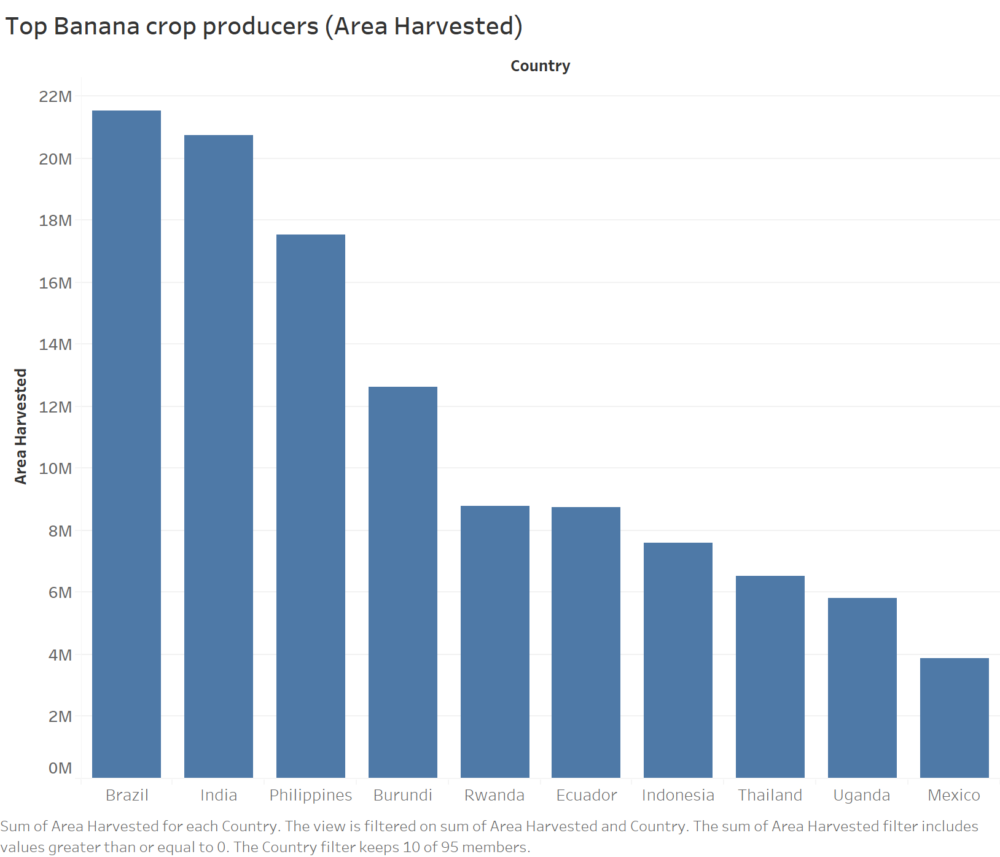


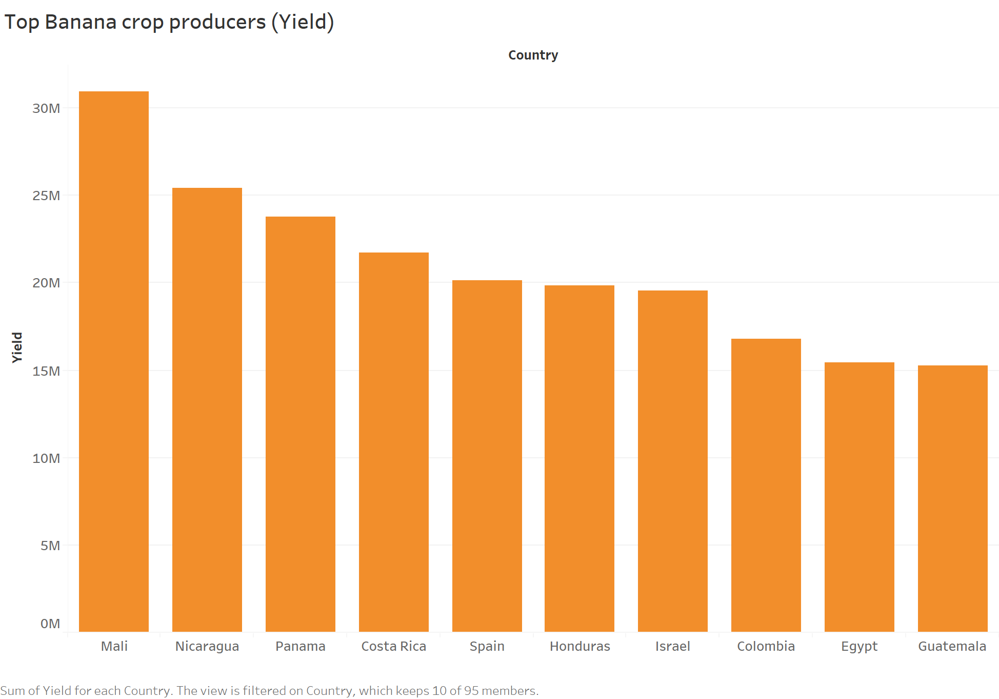

Area Harvested seems to have no co-relation with Yield at all. I've done multiple sanity checks. There is no statistically significant co-relation between the area in hectares of crop plantations and the yield of the crop produced. Value of p > 0.05.

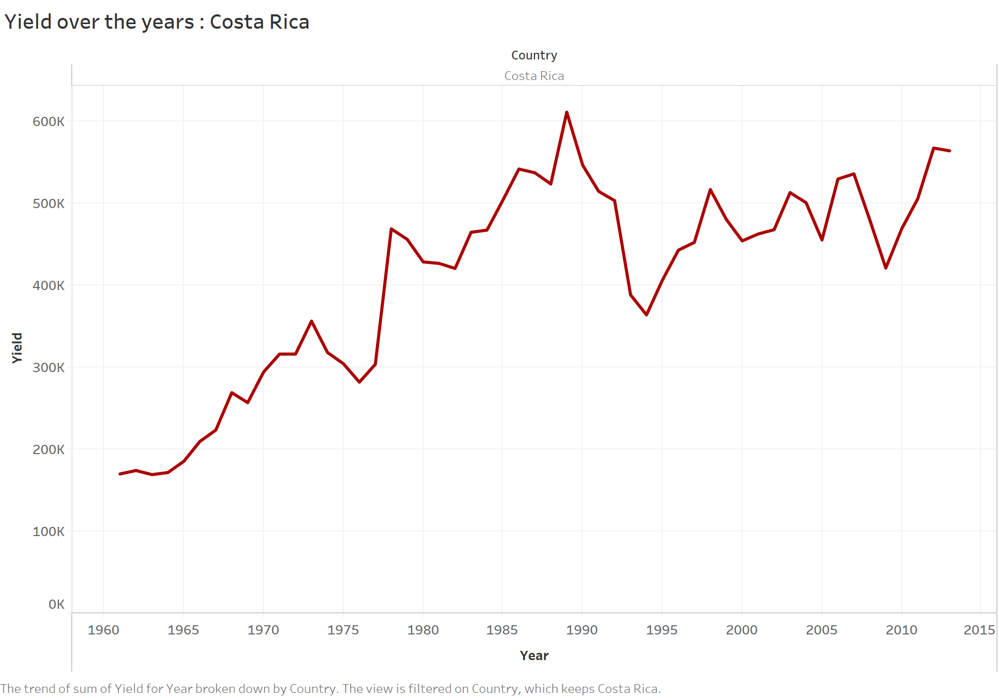

There is so much intuition to be found as to why the yield graph varies so drasctically country to country. Let's consider one case study : Costa Rica. 

Banana plantations have a complicated and dark history in most Central American countries, the plantations were built on the back of slavery during colonial times. The banana crop industry is, even at the moment embroiled in several labour and enviromental lawsuits. A lot of steep drops in the yield graph for Costa Rica can be traced to these reasons.  

Source : <https://foodispower.org/our-food-choices/bananas/> 

It is becoming increasingly evident to me then that it is impossible to actually build a very accurate model based solely on these environment stress parameters. Banana cultivaton is also influenced by multiple macroeconomic factors and obtaining this data will not be as simple as downloading a dataset from Kaggle for example. 

The Gros Michel banana went extinct in the early 1960s. The data set begins after that date but you will notice most of the time, for most countries, the data starts at a very low point in 1960. At this point we only had one species of Banana left and that's the Cavendish. And most bananas produced today are just clones of this. 

2008-2009 and then 2013 was a bad year for bananas. Entire plantations were wiped out due to the Tropical Race 4 fungus in parts of Africa. If you look at the graph for Mali for example or Algeria, that will be reflected there. In the case of Costa Rica, however, 2009 was a bad year in terms of weather. 

Source: <https://en.centralamericadata.com/en/article/data/Banana_Exports_Rebound_in_Costa_Rica>

Disease is a BIG factor. Incorporating disease data into this dataset will go a long way towards improving accuracy. But I also need to think about what disease data would need to look like for this use case. 


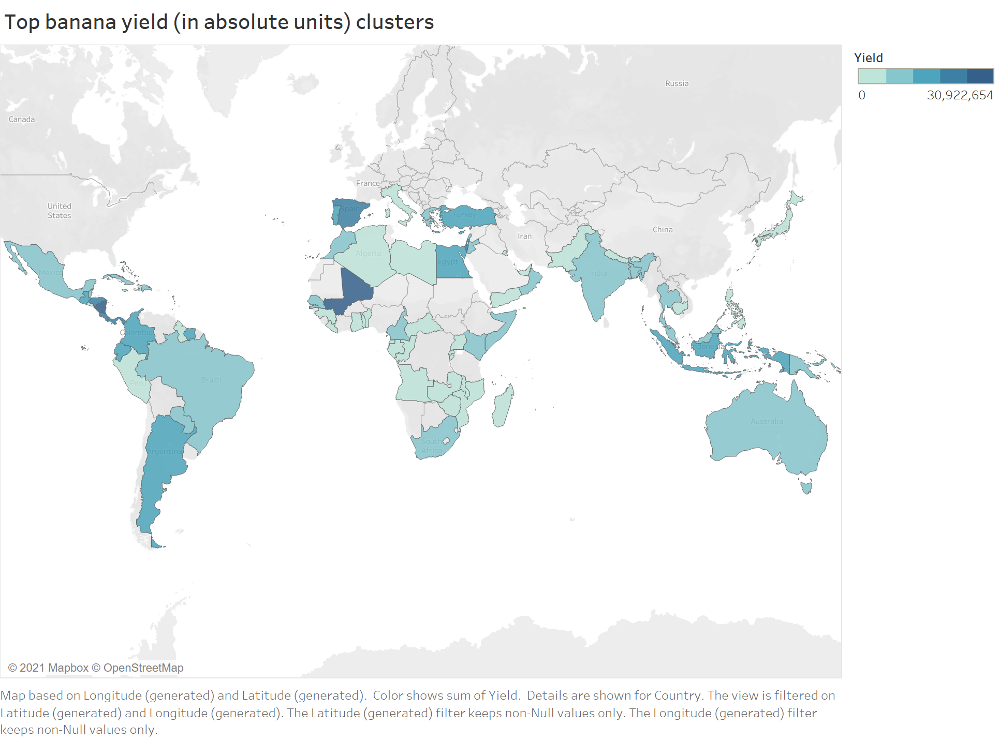

Here's a map clustering the top banana producers into their respective continents and the heatmap shows the most concentrated clusters. 

The workbook has the remainder of the visuals I built during the EDA. But I thought these were the most relevant, hence why they're in my notebook. 

____________________________________________________________________________________________________________________________

### Let's do some feature engineering before we start building models. 

### Step 7 : Feature engineering of the only categorical column in the table : countries 

In [65]:
# instantiate encoder
ohe = OneHotEncoder()

# 2D array required so store as dataframe
country = pd.DataFrame(df2_banana['Country'])

# fit and transform data
encoded = ohe.fit_transform(country)

# interpret
encoded

<4902x95 sparse matrix of type '<class 'numpy.float64'>'
	with 4902 stored elements in Compressed Sparse Row format>

In [66]:
# convert from sparse to dense
dense_array = encoded.toarray()
dense_array

array([[1., 0., 0., ..., 0., 0., 0.],
       [0., 1., 0., ..., 0., 0., 0.],
       [0., 0., 1., ..., 0., 0., 0.],
       ...,
       [0., 0., 0., ..., 1., 0., 0.],
       [0., 0., 0., ..., 0., 1., 0.],
       [0., 0., 0., ..., 0., 0., 1.]])

In [67]:
# viewing classes stored in encoder
ohe.categories_

[array(['Africa', 'Algeria', 'Angola', 'Argentina', 'Australia', 'Bahamas',
        'Bahrain', 'Bangladesh', 'Barbados', 'Belize', 'Benin', 'Bhutan',
        'Brazil', 'Burundi', 'Cambodia', 'Cameroon',
        'Central African Republic', 'Colombia', 'Comoros', 'Congo',
        'Costa Rica', 'Cuba', 'Cyprus', 'Dominica', 'Dominican Republic',
        'Ecuador', 'Egypt', 'El Salvador', 'Equatorial Guinea', 'Fiji',
        'French Polynesia', 'Gabon', 'Ghana', 'Greece', 'Grenada',
        'Guadeloupe', 'Guatemala', 'Guinea', 'Guyana', 'Haiti', 'Honduras',
        'India', 'Indonesia', 'Israel', 'Italy', 'Jamaica', 'Japan',
        'Jordan', 'Kenya', 'Kiribati', 'Kuwait', 'Lebanon', 'Liberia',
        'Libya', 'Madagascar', 'Malawi', 'Malaysia', 'Mali', 'Martinique',
        'Mauritius', 'Mexico', 'Morocco', 'Mozambique', 'Nepal',
        'New Caledonia', 'Nicaragua', 'Niue', 'Oman', 'Pakistan', 'Panama',
        'Papua New Guinea', 'Paraguay', 'Peru', 'Philippines', 'Portugal',
        '

In [68]:
# Put into a dataframe to get column names
country_df = pd.DataFrame(dense_array, columns=ohe.categories_[0], dtype=int)

# Show
country_df.head()

,Africa,Algeria,Angola,Argentina,Australia,Bahamas,Bahrain,Bangladesh,Barbados,Belize,...,Suriname,Thailand,Togo,Tonga,Turkey,Uganda,United Arab Emirates,Yemen,Zambia,Zimbabwe
0,1,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,0,1,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,0,0,1,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,0,0,0,1,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,0,0,0,0,1,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [69]:
# check dimensions for OHE dataframes (any mistakes?)
print(df2_banana.shape,
      country_df.shape)

(4902, 9) (4902, 95)


In [70]:
df2_banana.reset_index(drop=True, inplace=True)
country_df.reset_index(drop=True, inplace=True)

In [71]:
# concatenate all dataframes into one
df2_banana_ohe = pd.concat([df2_banana, country_df], axis=1)

In [72]:
df2_banana_ohe.head()

,Year,Country,Item,Area Harvested,Production,Yield,CO2_GHG,GMSL,AverageTemperature,Africa,...,Suriname,Thailand,Togo,Tonga,Turkey,Uganda,United Arab Emirates,Yemen,Zambia,Zimbabwe
0,1961,Africa,Bananas,530320.0,3204079.0,60418.0,1.619943e+08,-38.091667,24.028500,1,...,0,0,0,0,0,0,0,0,0,0
1,1961,Algeria,Bananas,0.0,0.0,0.0,6.055917e+06,-38.091667,23.390333,0,...,0,0,0,0,0,0,0,0,0,0
2,1961,Angola,Bananas,20000.0,175000.0,87500.0,4.537120e+05,-38.091667,21.938750,0,...,0,0,0,0,0,0,0,0,0,0
3,1961,Argentina,Bananas,480.0,11649.0,242688.0,5.112671e+07,-38.091667,14.972917,0,...,0,0,0,0,0,0,0,0,0,0
4,1961,Australia,Bananas,10353.0,123863.0,119640.0,9.050390e+07,-38.091667,21.964250,0,...,0,0,0,0,0,0,0,0,0,0


Looks okay, moving on. 

The production and the yield metrics are the exact same, the only difference is in units vs a weight metric(like kgs), SO i'm going to drop production to help the model along and we'll drop the column 'item' as well, since we know that in this dataframe its only bananas. 

Also, very curious to see there is a column called 'Africa'. I haven't done any clustering, so it is a part of the original dataset. But its redundant, because there are African countries in the dataset and so I will be dropping it later on. 

In [73]:
df2_banana_ohe.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4902 entries, 0 to 4901
Columns: 104 entries, Year to Zimbabwe
dtypes: float64(6), int32(95), int64(1), object(2)
memory usage: 2.1+ MB


In [74]:
columns_to_drop = ['Item', 'Production', 'Country']

df2_banana_ohe.drop(columns_to_drop, axis=1, inplace=True)
df2_banana_ohe.head()

,Year,Area Harvested,Yield,CO2_GHG,GMSL,AverageTemperature,Africa,Algeria,Angola,Argentina,...,Suriname,Thailand,Togo,Tonga,Turkey,Uganda,United Arab Emirates,Yemen,Zambia,Zimbabwe
0,1961,530320.0,60418.0,1.619943e+08,-38.091667,24.028500,1,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,1961,0.0,0.0,6.055917e+06,-38.091667,23.390333,0,1,0,0,...,0,0,0,0,0,0,0,0,0,0
2,1961,20000.0,87500.0,4.537120e+05,-38.091667,21.938750,0,0,1,0,...,0,0,0,0,0,0,0,0,0,0
3,1961,480.0,242688.0,5.112671e+07,-38.091667,14.972917,0,0,0,1,...,0,0,0,0,0,0,0,0,0,0
4,1961,10353.0,119640.0,9.050390e+07,-38.091667,21.964250,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


Now there are two ways we can go about this. We can assume that yield is a function of area harvested without making any changes, or we do so by desinging a new feature that actually is a ratio of some kind between the two. I'm going to try the first method. I'm going to use area harvested as an independant variable and the yield as a dependant without making any changes to the them.  

In [75]:
df2_banana_ohe['Yield'].median()

101980.5

In [76]:
#Make a copy in case i want to use the original dataset later
df3_banana = df2_banana_ohe.copy()

In [77]:
df3_banana.head()

,Year,Area Harvested,Yield,CO2_GHG,GMSL,AverageTemperature,Africa,Algeria,Angola,Argentina,...,Suriname,Thailand,Togo,Tonga,Turkey,Uganda,United Arab Emirates,Yemen,Zambia,Zimbabwe
0,1961,530320.0,60418.0,1.619943e+08,-38.091667,24.028500,1,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,1961,0.0,0.0,6.055917e+06,-38.091667,23.390333,0,1,0,0,...,0,0,0,0,0,0,0,0,0,0
2,1961,20000.0,87500.0,4.537120e+05,-38.091667,21.938750,0,0,1,0,...,0,0,0,0,0,0,0,0,0,0
3,1961,480.0,242688.0,5.112671e+07,-38.091667,14.972917,0,0,0,1,...,0,0,0,0,0,0,0,0,0,0
4,1961,10353.0,119640.0,9.050390e+07,-38.091667,21.964250,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


We've made a copy of the dataframe because to build a logistic regression I need to bin/binarise my target variable. But when I build a time series analysis, I won't be needing it. I'll use df2_banana for that one and df3_banana for the logistic regression. I've decided I'm going to binarise my target variable. I've checked the median value which is about **100,000 units**. I'm going to say anything higher than that is good, so 1 and anything below that is bad, so 0. And then assign this variable to y.  

In [78]:
# >100,000 is 1 and <100,000 is 0
df3_banana['Yield'] = np.where((df3_banana['Yield']> 100000), 1, 0)

In [79]:
df3_banana["Yield"].value_counts()

1    2473
0    2429
Name: Yield, dtype: int64

Excellent, we've binarised our target variable. We seem to also be good with the class imbalance. 

### Step 8 : Modeling and Model Evaluation 

In [80]:
# Set up X (i.e., independent variables; features) and y (i.e., dependent variable; target)
X = df3_banana.drop('Yield', axis=1)
y = df3_banana['Yield']

# Print shapes
print('Shape of X:', X.shape)
print('Shape of y:', y.shape)

Shape of X: (4902, 100)
Shape of y: (4902,)


Awesome, now for the remainder-test split. 

In [81]:
# Split the data into remainder and test sets
X_rem, X_test, y_rem, y_test = train_test_split(X, y, test_size=0.3, random_state=1, stratify=y)

# Print info on how the data has been split
print(f'The remainder set has {len(X_rem)} data points.')
print(f'The test set has {len(X_test)} data points.')

The remainder set has 3431 data points.
The test set has 1471 data points.


Great. Now we'll scale the data. 

In [82]:
#Scale sets
scaler = StandardScaler()
scaler.fit(X_rem)
X_rem_ss = scaler.transform(X_rem)
X_test_ss = scaler.transform(X_test)

### Modeling attempt no 1 : Logistic Regression Model

In [83]:
# Baseline logistic regression
# Instantiate and fit to the remainder set
baseline_logreg = LogisticRegression(solver='lbfgs', random_state=1).fit(X_rem, y_rem)

# Print the accuracies
print(f'Accuracy on remainder set: {baseline_logreg.score(X_rem, y_rem)}')
print(f'Accuracy on test set: {baseline_logreg.score(X_test, y_test)}')

Accuracy on remainder set: 0.5683474205770912
Accuracy on test set: 0.5479265805574439


Alright, so we were expecting that. Let's try tuning our parameters and then try again. 

In [84]:
%%time

# This is the range of C values 
c_values = [.00001, .0001, .001, .1, 1, 2, 6, 10, 100, 1000, 10000]

# Set up an empty list
cv_accuracies = []

# Iterate over the C values
for value in c_values:
    
    # Instantiate a log reg
    logreg = LogisticRegression(C=value, random_state=1, n_jobs=-1)
    
    # Pass the model and the remainder set into the cross-validation function, then get cross-validated accuracy by taking the mean
    cv_accuracy = np.mean(cross_val_score(logreg, X_rem, y_rem, cv=5, n_jobs=-1))
    
    # Append the cross-validated accuracy to the list set up above
    cv_accuracies.append(cv_accuracy)
    
    # Print something at the end of each iteration
    print(f'For a C value of {value}, the cross-validated accuracy is {(cv_accuracy)}')

For a C value of 1e-05, the cross-validated accuracy is 0.5680615852080071
For a C value of 0.0001, the cross-validated accuracy is 0.5680615852080071
For a C value of 0.001, the cross-validated accuracy is 0.5680615852080071
For a C value of 0.1, the cross-validated accuracy is 0.5680615852080071
For a C value of 1, the cross-validated accuracy is 0.5680615852080071
For a C value of 2, the cross-validated accuracy is 0.5680615852080071
For a C value of 6, the cross-validated accuracy is 0.5680615852080071
For a C value of 10, the cross-validated accuracy is 0.5680615852080071
For a C value of 100, the cross-validated accuracy is 0.5680615852080071
For a C value of 1000, the cross-validated accuracy is 0.5680615852080071
For a C value of 10000, the cross-validated accuracy is 0.5680615852080071
Wall time: 7.42 s


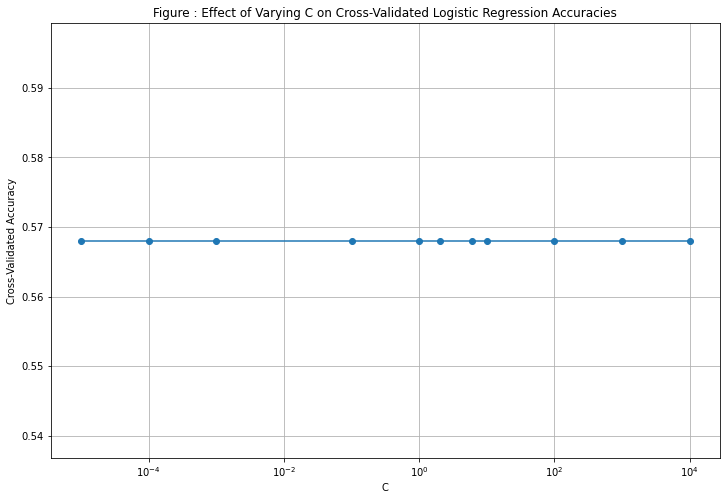

In [85]:
# Plot the accuracies
plt.figure(figsize=(12, 8))
plt.plot(c_values, cv_accuracies, marker = 'o')
plt.title('Figure : Effect of Varying C on Cross-Validated Logistic Regression Accuracies')
plt.xscale('log')
plt.xlabel('C')
plt.ylabel('Cross-Validated Accuracy')
plt.grid()
plt.show()

This is so strange and curious. The only explanation I found for this was that the model had nothing else to learn after the first fit. That doesn't make too much sense to me either. So I do not have an explanation for why I have the same accuracies on every value of c. 

In [86]:
#since it doesn't matter, I'll use a random c value
logreg = LogisticRegression(C=100, random_state=1).fit(X_rem, y_rem)

# Print the accuracies
print(f'Accuracy on remainder set: {logreg.score(X_rem, y_rem)}')
print(f'Accuracy on test set: {logreg.score(X_test, y_test)}')

Accuracy on remainder set: 0.5683474205770912
Accuracy on test set: 0.5479265805574439


I'm going to pull out the co-efficients for the model so I can design a more robust time series model. 

In [87]:
logreg = LogisticRegression()
logreg.fit(X_rem, y_rem)
log_odds = logreg.coef_[0]
pd.DataFrame(log_odds, 
             X_rem.columns, 
             columns=['coef'])\
            .sort_values(by='coef', ascending=False)

,coef
CO2_GHG,1.565637e-09
GMSL,3.471882e-10
Nicaragua,1.602948e-12
Bangladesh,1.516276e-12
Senegal,1.453059e-12
...,...
Cambodia,-1.606049e-12
Japan,-1.788020e-12
AverageTemperature,-7.696352e-11
Year,-4.694693e-09


We've seen some curious results after all this analysis. 

We see again that Area Harvested and Yield have no relationship. Emissions is highly co-related as we saw before. The countries too, are curious, its not the same result as on the graph. But while designing the time series, I'm going to pick three countries that that take precedence on both the graph and the log reg co-efficients. 

### Step 9 : Time Series Modelling 

In [88]:
#Let's use the original dataset
banana = df2_banana_ohe.copy()

In [89]:
banana.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4902 entries, 0 to 4901
Columns: 101 entries, Year to Zimbabwe
dtypes: float64(5), int32(95), int64(1)
memory usage: 2.0 MB


In [90]:
#Converting year to datetime format, we'll just use df3_banana, its easier
banana["Year"] = pd.to_datetime(df3_banana.Year, format='%Y')

In [91]:
banana.head()

,Year,Area Harvested,Yield,CO2_GHG,GMSL,AverageTemperature,Africa,Algeria,Angola,Argentina,...,Suriname,Thailand,Togo,Tonga,Turkey,Uganda,United Arab Emirates,Yemen,Zambia,Zimbabwe
0,1961-01-01,530320.0,60418.0,1.619943e+08,-38.091667,24.028500,1,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,1961-01-01,0.0,0.0,6.055917e+06,-38.091667,23.390333,0,1,0,0,...,0,0,0,0,0,0,0,0,0,0
2,1961-01-01,20000.0,87500.0,4.537120e+05,-38.091667,21.938750,0,0,1,0,...,0,0,0,0,0,0,0,0,0,0
3,1961-01-01,480.0,242688.0,5.112671e+07,-38.091667,14.972917,0,0,0,1,...,0,0,0,0,0,0,0,0,0,0
4,1961-01-01,10353.0,119640.0,9.050390e+07,-38.091667,21.964250,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [92]:
banana.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4902 entries, 0 to 4901
Columns: 101 entries, Year to Zimbabwe
dtypes: datetime64[ns](1), float64(5), int32(95)
memory usage: 2.0 MB


In [93]:
#Setting the index to time
banana_final = banana.set_index("Year")
banana_final.index

DatetimeIndex(['1961-01-01', '1961-01-01', '1961-01-01', '1961-01-01',
               '1961-01-01', '1961-01-01', '1961-01-01', '1961-01-01',
               '1961-01-01', '1961-01-01',
               ...
               '2013-01-01', '2013-01-01', '2013-01-01', '2013-01-01',
               '2013-01-01', '2013-01-01', '2013-01-01', '2013-01-01',
               '2013-01-01', '2013-01-01'],
              dtype='datetime64[ns]', name='Year', length=4902, freq=None)

In [94]:
banana_final.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 4902 entries, 1961-01-01 to 2013-01-01
Data columns (total 100 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   Area Harvested            4902 non-null   float64
 1   Yield                     4902 non-null   float64
 2   CO2_GHG                   4902 non-null   float64
 3   GMSL                      4902 non-null   float64
 4   AverageTemperature        4902 non-null   float64
 5   Africa                    4902 non-null   int32  
 6   Algeria                   4902 non-null   int32  
 7   Angola                    4902 non-null   int32  
 8   Argentina                 4902 non-null   int32  
 9   Australia                 4902 non-null   int32  
 10  Bahamas                   4902 non-null   int32  
 11  Bahrain                   4902 non-null   int32  
 12  Bangladesh                4902 non-null   int32  
 13  Barbados                  4902 non-null   in

A quick bit of EDA first. 

In [95]:
# add lines for each column
fig = px.line(banana_final, x=banana_final.index, y=banana_final.columns,)

# axis labels and title
fig.update_layout(
    yaxis_title="Production data", 
    legend_title="", 
    title="Banana production from 1961 to 2013"
)

# activate slider
fig.update_xaxes(rangeslider_visible=True)

fig.show()

I believe we're seeing about the same things as before. Except for the countries, since the values are 1 or 0, the graphs are a bit strange looking. But it is all well, it is as we expect.

We'll first build a wholesome time series graph for the entire yield.

In [96]:
y = banana_final['Yield'].resample('Y').mean()

In [97]:
y['1995':]

Year
1995-12-31    159474.547368
1996-12-31    159756.715789
1997-12-31    156824.789474
1998-12-31    156851.663158
1999-12-31    159111.284211
2000-12-31    158162.368421
2001-12-31    161563.715789
2002-12-31    166940.021053
2003-12-31    169878.578947
2004-12-31    169521.094737
2005-12-31    177636.446809
2006-12-31    175399.074468
2007-12-31    171822.815217
2008-12-31    170694.369565
2009-12-31    176239.402174
2010-12-31    178929.456522
2011-12-31    180186.663043
2012-12-31    186925.923913
2013-12-31    193542.695652
Freq: A-DEC, Name: Yield, dtype: float64

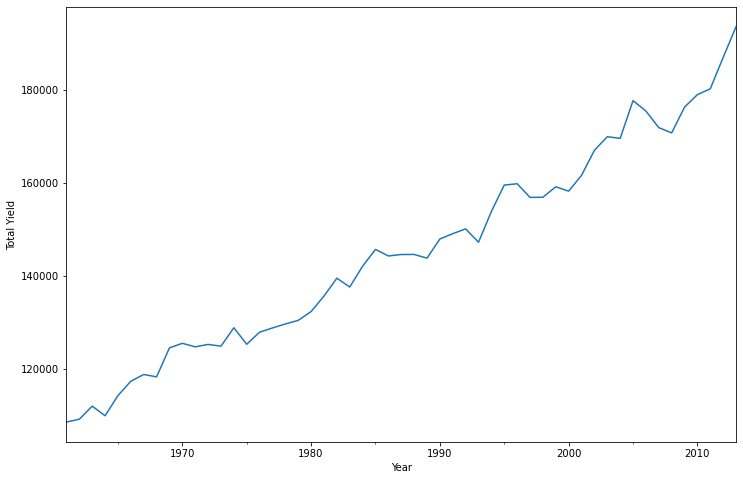

In [98]:
y.plot(figsize=(12, 8))
plt.ylabel('Total Yield')
plt.show()

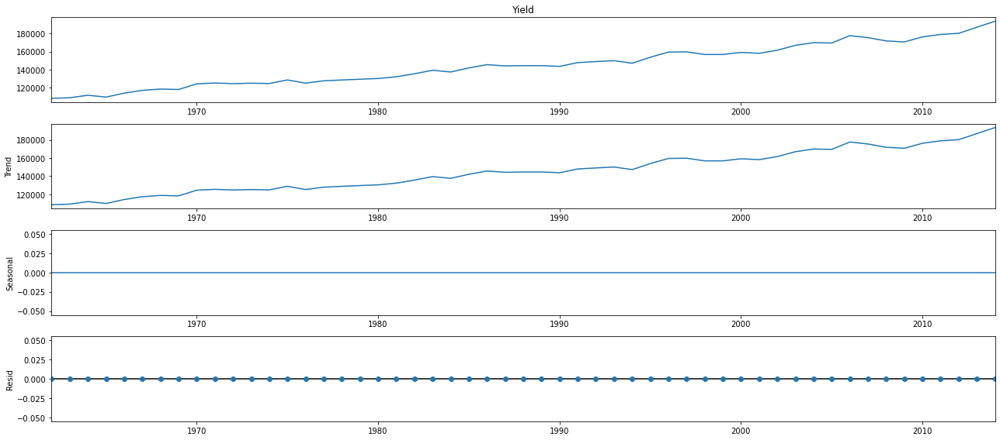

In [99]:
from pylab import rcParams
rcParams['figure.figsize'] = 18, 8
decomposition = sm.tsa.seasonal_decompose(y, model='additive')
fig = decomposition.plot()
plt.show()

These graphs indicate that there is no seasonality in banana crop production. Which in the context of our understanding of the banana crop culture, we understand that there are a few big companies that control the production of Banana and hence seasonality of the crop itself doesn't play into this monopoly. Banana is available all year round. 

In [100]:
import itertools
import operator
p = d = q = range(0, 2)
pdq = list(itertools.product(p, d, q))
seasonal_pdq = [(x[0], x[1], x[2], 12) for x in list(itertools.product(p, d, q))]
print('Examples of parameter combinations for Seasonal ARIMA...')
print('SARIMAX: {} x {}'.format(pdq[1], seasonal_pdq[1]))
print('SARIMAX: {} x {}'.format(pdq[1], seasonal_pdq[2]))
print('SARIMAX: {} x {}'.format(pdq[2], seasonal_pdq[3]))
print('SARIMAX: {} x {}'.format(pdq[2], seasonal_pdq[4]))

Examples of parameter combinations for Seasonal ARIMA...
SARIMAX: (0, 0, 1) x (0, 0, 1, 12)
SARIMAX: (0, 0, 1) x (0, 1, 0, 12)
SARIMAX: (0, 1, 0) x (0, 1, 1, 12)
SARIMAX: (0, 1, 0) x (1, 0, 0, 12)


Let's do a grid search to find optimum value for AIC and then we will build our model based on that.

In [101]:
for param in pdq:
    for param_seasonal in seasonal_pdq:
        try:
            mod = sm.tsa.statespace.SARIMAX(y,
                                            order=param,
                                            seasonal_order=param_seasonal,
                                            enforce_stationarity=False, 
                                            enforce_invertibility=False)

            results = mod.fit()
            print('ARIMA{}x{}12 - AIC:{}'.format(param, param_seasonal, results.aic))
        except:
            continue

ARIMA(0, 0, 0)x(0, 0, 0, 12)12 - AIC:1387.2803999347732
ARIMA(0, 0, 0)x(0, 0, 1, 12)12 - AIC:171051.54657830505
ARIMA(0, 0, 0)x(0, 1, 0, 12)12 - AIC:899.6689602135505


C:\Users\The PRO\anaconda3\lib\site-packages\statsmodels\base\model.py:566: ConvergenceWarning:

Maximum Likelihood optimization failed to converge. Check mle_retvals



ARIMA(0, 0, 0)x(0, 1, 1, 12)12 - AIC:1191.2650739072851
ARIMA(0, 0, 0)x(1, 0, 0, 12)12 - AIC:811.2967189305689
ARIMA(0, 0, 0)x(1, 0, 1, 12)12 - AIC:797.1703444088706
ARIMA(0, 0, 0)x(1, 1, 0, 12)12 - AIC:600.8263098749608
ARIMA(0, 0, 0)x(1, 1, 1, 12)12 - AIC:583.311476803998
ARIMA(0, 0, 1)x(0, 0, 0, 12)12 - AIC:13868.167682616719


C:\Users\The PRO\anaconda3\lib\site-packages\statsmodels\base\model.py:566: ConvergenceWarning:

Maximum Likelihood optimization failed to converge. Check mle_retvals



ARIMA(0, 0, 1)x(0, 0, 1, 12)12 - AIC:177133.99060201808
ARIMA(0, 0, 1)x(0, 1, 0, 12)12 - AIC:857.0565990182854


C:\Users\The PRO\anaconda3\lib\site-packages\statsmodels\base\model.py:566: ConvergenceWarning:

Maximum Likelihood optimization failed to converge. Check mle_retvals



ARIMA(0, 0, 1)x(0, 1, 1, 12)12 - AIC:1433.6005764137292
ARIMA(0, 0, 1)x(1, 0, 0, 12)12 - AIC:1139.1948815479282
ARIMA(0, 0, 1)x(1, 0, 1, 12)12 - AIC:1073.341675508973
ARIMA(0, 0, 1)x(1, 1, 0, 12)12 - AIC:631.3225983557182
ARIMA(0, 0, 1)x(1, 1, 1, 12)12 - AIC:589.5774899806473
ARIMA(0, 1, 0)x(0, 0, 0, 12)12 - AIC:974.5512593114616
ARIMA(0, 1, 0)x(0, 0, 1, 12)12 - AIC:750.6147163541184
ARIMA(0, 1, 0)x(0, 1, 0, 12)12 - AIC:770.7935306720859


C:\Users\The PRO\anaconda3\lib\site-packages\statsmodels\base\model.py:566: ConvergenceWarning:

Maximum Likelihood optimization failed to converge. Check mle_retvals



ARIMA(0, 1, 0)x(0, 1, 1, 12)12 - AIC:1224.9097035391774
ARIMA(0, 1, 0)x(1, 0, 0, 12)12 - AIC:770.0731624990659
ARIMA(0, 1, 0)x(1, 0, 1, 12)12 - AIC:750.9239151250279
ARIMA(0, 1, 0)x(1, 1, 0, 12)12 - AIC:550.4424082261833


C:\Users\The PRO\anaconda3\lib\site-packages\statsmodels\base\model.py:566: ConvergenceWarning:

Maximum Likelihood optimization failed to converge. Check mle_retvals



ARIMA(0, 1, 0)x(1, 1, 1, 12)12 - AIC:932.5049429494826
ARIMA(0, 1, 1)x(0, 0, 0, 12)12 - AIC:956.0611419875365
ARIMA(0, 1, 1)x(0, 0, 1, 12)12 - AIC:729.7888904546776
ARIMA(0, 1, 1)x(0, 1, 0, 12)12 - AIC:750.7293245872766


C:\Users\The PRO\anaconda3\lib\site-packages\statsmodels\base\model.py:566: ConvergenceWarning:

Maximum Likelihood optimization failed to converge. Check mle_retvals



ARIMA(0, 1, 1)x(0, 1, 1, 12)12 - AIC:1314.4215062873384
ARIMA(0, 1, 1)x(1, 0, 0, 12)12 - AIC:766.2090005600501
ARIMA(0, 1, 1)x(1, 0, 1, 12)12 - AIC:731.126174430641
ARIMA(0, 1, 1)x(1, 1, 0, 12)12 - AIC:552.4859696785204


C:\Users\The PRO\anaconda3\lib\site-packages\statsmodels\base\model.py:566: ConvergenceWarning:

Maximum Likelihood optimization failed to converge. Check mle_retvals



ARIMA(0, 1, 1)x(1, 1, 1, 12)12 - AIC:1173.9174205015472
ARIMA(1, 0, 0)x(0, 0, 0, 12)12 - AIC:979.6826633023682
ARIMA(1, 0, 0)x(0, 0, 1, 12)12 - AIC:754.4604389808808
ARIMA(1, 0, 0)x(0, 1, 0, 12)12 - AIC:792.0155874772463
ARIMA(1, 0, 0)x(0, 1, 1, 12)12 - AIC:1323.3699889639397
ARIMA(1, 0, 0)x(1, 0, 0, 12)12 - AIC:754.9847624382085
ARIMA(1, 0, 0)x(1, 0, 1, 12)12 - AIC:756.904927114836
ARIMA(1, 0, 0)x(1, 1, 0, 12)12 - AIC:552.7891841849644
ARIMA(1, 0, 0)x(1, 1, 1, 12)12 - AIC:554.7851636422944
ARIMA(1, 0, 1)x(0, 0, 0, 12)12 - AIC:963.240115669354
ARIMA(1, 0, 1)x(0, 0, 1, 12)12 - AIC:738.0476410517139
ARIMA(1, 0, 1)x(0, 1, 0, 12)12 - AIC:774.4185966772079


C:\Users\The PRO\anaconda3\lib\site-packages\statsmodels\base\model.py:566: ConvergenceWarning:

Maximum Likelihood optimization failed to converge. Check mle_retvals



ARIMA(1, 0, 1)x(0, 1, 1, 12)12 - AIC:1327.5764758093824
ARIMA(1, 0, 1)x(1, 0, 0, 12)12 - AIC:802.21667718224
ARIMA(1, 0, 1)x(1, 0, 1, 12)12 - AIC:740.0421856613762
ARIMA(1, 0, 1)x(1, 1, 0, 12)12 - AIC:554.2167406309891
ARIMA(1, 0, 1)x(1, 1, 1, 12)12 - AIC:537.0986539087262
ARIMA(1, 1, 0)x(0, 0, 0, 12)12 - AIC:974.7142031783225
ARIMA(1, 1, 0)x(0, 0, 1, 12)12 - AIC:749.2327910500513
ARIMA(1, 1, 0)x(0, 1, 0, 12)12 - AIC:772.041290080995


C:\Users\The PRO\anaconda3\lib\site-packages\statsmodels\base\model.py:566: ConvergenceWarning:

Maximum Likelihood optimization failed to converge. Check mle_retvals



ARIMA(1, 1, 0)x(0, 1, 1, 12)12 - AIC:1215.2414775963055
ARIMA(1, 1, 0)x(1, 0, 0, 12)12 - AIC:748.7084382909527
ARIMA(1, 1, 0)x(1, 0, 1, 12)12 - AIC:750.4641683790775
ARIMA(1, 1, 0)x(1, 1, 0, 12)12 - AIC:533.7310332876648


C:\Users\The PRO\anaconda3\lib\site-packages\statsmodels\base\model.py:566: ConvergenceWarning:

Maximum Likelihood optimization failed to converge. Check mle_retvals



ARIMA(1, 1, 0)x(1, 1, 1, 12)12 - AIC:1200.795977805088
ARIMA(1, 1, 1)x(0, 0, 0, 12)12 - AIC:956.765374008457
ARIMA(1, 1, 1)x(0, 0, 1, 12)12 - AIC:724.8174606939122
ARIMA(1, 1, 1)x(0, 1, 0, 12)12 - AIC:751.9559706887369


C:\Users\The PRO\anaconda3\lib\site-packages\statsmodels\base\model.py:566: ConvergenceWarning:

Maximum Likelihood optimization failed to converge. Check mle_retvals



ARIMA(1, 1, 1)x(0, 1, 1, 12)12 - AIC:943.2756860793838
ARIMA(1, 1, 1)x(1, 0, 0, 12)12 - AIC:747.019779279279
ARIMA(1, 1, 1)x(1, 0, 1, 12)12 - AIC:725.6168325722367
ARIMA(1, 1, 1)x(1, 1, 0, 12)12 - AIC:535.5763064142684
ARIMA(1, 1, 1)x(1, 1, 1, 12)12 - AIC:1390.8051902393613


C:\Users\The PRO\anaconda3\lib\site-packages\statsmodels\base\model.py:566: ConvergenceWarning:

Maximum Likelihood optimization failed to converge. Check mle_retvals



ARIMA(1, 1, 0)x(1, 1, 0, 12)12 - AIC:549.4819005915854, seems to have the least value of AIC. So we'll consider this our optimal model.

In [102]:
#Fit the model
mod = sm.tsa.statespace.SARIMAX(y,
                                order=(1, 1, 0),
                                seasonal_order=(1, 1, 0, 12),
                                enforce_stationarity=False,
                                enforce_invertibility=False)
results = mod.fit()
print(results.summary().tables[1])

                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -0.0140      0.223     -0.063      0.950      -0.451       0.423
ar.S.L12      -0.6951      0.260     -2.668      0.008      -1.206      -0.185
sigma2       2.09e+07   3.43e-10   6.09e+16      0.000    2.09e+07    2.09e+07


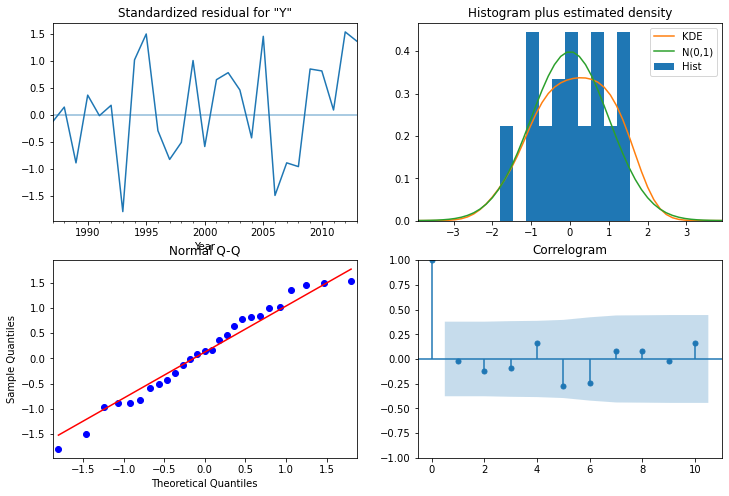

In [103]:
#Let's also construct plot diagnostics 
results.plot_diagnostics(figsize=(12, 8))
plt.show()

Not a great model, by any means. The correlogram points towards the 2nd and the 9th lag being statistically significant. There are some negative co-relations for lag 5 and 6, there is some data there that our model failed to capture. Quantiles do not seem to be a great fit, either. There also seem to be some weird patters with the residuals, the histogram is not a pure normal distribution either. 

Let's try making a one step forecast.

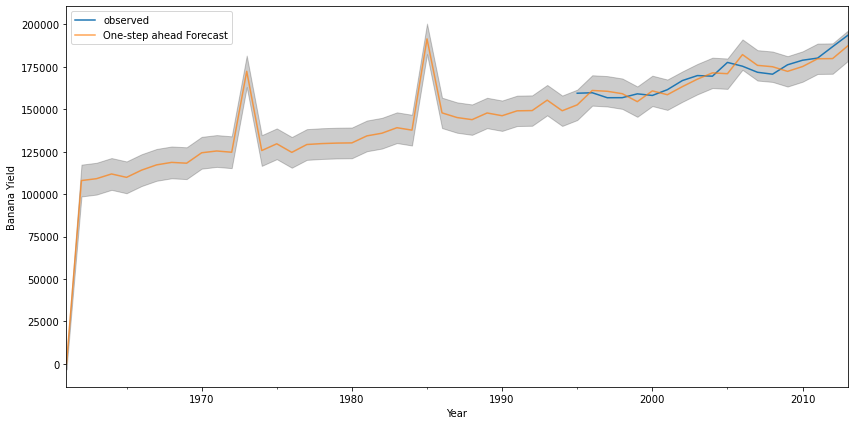

In [104]:
pred = results.get_prediction(start=pd.to_datetime('1961-12-31'), dynamic=False)
pred_ci = pred.conf_int()
ax = y['1995':].plot(label='observed')
pred.predicted_mean.plot(ax=ax, label='One-step ahead Forecast', alpha=.7, figsize=(14, 7))
ax.fill_between(pred_ci.index,
                pred_ci.iloc[:, 0],
                pred_ci.iloc[:, 1], color='k', alpha=.2)
ax.set_xlabel('Year')
ax.set_ylabel('Banana Yield')
plt.legend()
plt.show()

I'm going to use RMSE instead of MAPE here because the only difference between them is, MAPE measures the deviation from the actual data in terms of percentage. The similarity between them is they both measure the absolute error. So in both the negative and the positive errors, cancel out each other. RMSE method then seems to me a more accurate indicator.

In [105]:
y_forecasted = pred.predicted_mean
y_truth = y['1961-12-31':]
mse = ((y_forecasted - y_truth) ** 2).mean()
print('The Mean Squared Error of our forecasts is {}'.format(round(mse, 2)))

The Mean Squared Error of our forecasts is 316936228.39


In [106]:
print('The Root Mean Squared Error of our forecasts is {}'.format(round(np.sqrt(mse), 2)))

The Root Mean Squared Error of our forecasts is 17802.7


In [107]:
banana_final['Yield'].min()

0.0

In [108]:
banana_final['Yield'].max()

775922.0

Considering the min and max values, RMSE is definitely not that bad, all considered. I had had so many realisations while building this model. I did expect to see a MUCH worse result than I am seeing. 

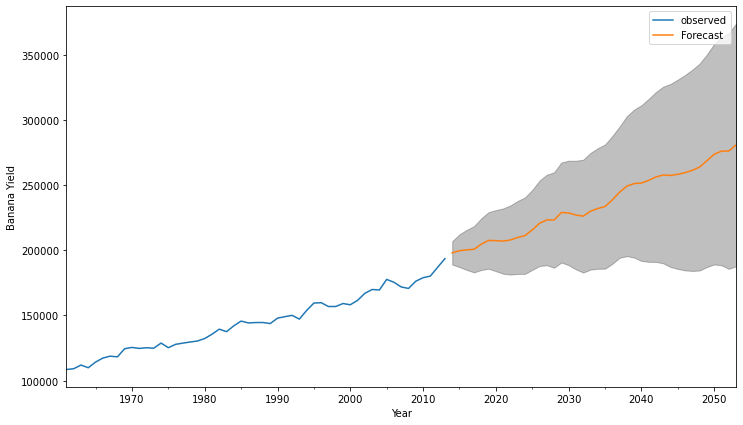

In [109]:
pred_uc = results.get_forecast(steps=40)
pred_ci = pred_uc.conf_int()
ax = y.plot(label='observed', figsize=(12, 7))
pred_uc.predicted_mean.plot(ax=ax, label='Forecast')
ax.fill_between(pred_ci.index,
                pred_ci.iloc[:, 0],
                pred_ci.iloc[:, 1], color='k', alpha=.25)
ax.set_xlabel('Year')
ax.set_ylabel('Banana Yield')
plt.legend()
plt.show()

And there we have it. Our model is predicting that bananas are only going to do better for the three decades. We've kept it to three decades because of the uncertainty going in. The forecast could be right. It is likely that Bananas won't go completely extinct for the next three decades at least because of the way the crop cultivation cycles are structured. But if the model is wrong, then there are also really good arguments for why the banana crop is going to go extinct sooner rather than later. For all means and purposes, banana as a diverse crop is already extinct. What passes for a banana these days is just a clone of the only remaining species : the Cavendish banana. 

I do beleieve that there is literature that speculates about the Gros Michel banana being grown in some parts still, under other names though. This crop culture hasn't yet caught on to the world at large, however. 

But let's try to narrow down our forecast to sepcific countries. 

From our EDA and from the Logistic Regression model, we'll pick the top 3 producers of Banana in terms of Yield and drop the rest. 

In [110]:
banana_final.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 4902 entries, 1961-01-01 to 2013-01-01
Data columns (total 100 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   Area Harvested            4902 non-null   float64
 1   Yield                     4902 non-null   float64
 2   CO2_GHG                   4902 non-null   float64
 3   GMSL                      4902 non-null   float64
 4   AverageTemperature        4902 non-null   float64
 5   Africa                    4902 non-null   int32  
 6   Algeria                   4902 non-null   int32  
 7   Angola                    4902 non-null   int32  
 8   Argentina                 4902 non-null   int32  
 9   Australia                 4902 non-null   int32  
 10  Bahamas                   4902 non-null   int32  
 11  Bahrain                   4902 non-null   int32  
 12  Bangladesh                4902 non-null   int32  
 13  Barbados                  4902 non-null   in

In [111]:
banana_final.head()

,Area Harvested,Yield,CO2_GHG,GMSL,AverageTemperature,Africa,Algeria,Angola,Argentina,Australia,...,Suriname,Thailand,Togo,Tonga,Turkey,Uganda,United Arab Emirates,Yemen,Zambia,Zimbabwe
Year,,,,,,,,,,,,,,,,,,,,,
1961-01-01,530320.0,60418.0,1.619943e+08,-38.091667,24.028500,1,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1961-01-01,0.0,0.0,6.055917e+06,-38.091667,23.390333,0,1,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1961-01-01,20000.0,87500.0,4.537120e+05,-38.091667,21.938750,0,0,1,0,0,...,0,0,0,0,0,0,0,0,0,0
1961-01-01,480.0,242688.0,5.112671e+07,-38.091667,14.972917,0,0,0,1,0,...,0,0,0,0,0,0,0,0,0,0
1961-01-01,10353.0,119640.0,9.050390e+07,-38.091667,21.964250,0,0,0,0,1,...,0,0,0,0,0,0,0,0,0,0


In [112]:
banana_final.duplicated().sum()

0

In [113]:
banana_final = banana_final.loc[:, banana_final.columns.intersection(['Area Harvested','CO2_GHG','GMSL',
                                                                      'AverageTemperature', 
                                                                     'Yield','Mali', 'Costa Rica','Honduras'])]

In [114]:
banana_final.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 4902 entries, 1961-01-01 to 2013-01-01
Data columns (total 8 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   Area Harvested      4902 non-null   float64
 1   Yield               4902 non-null   float64
 2   CO2_GHG             4902 non-null   float64
 3   GMSL                4902 non-null   float64
 4   AverageTemperature  4902 non-null   float64
 5   Costa Rica          4902 non-null   int32  
 6   Honduras            4902 non-null   int32  
 7   Mali                4902 non-null   int32  
dtypes: float64(5), int32(3)
memory usage: 287.2 KB


In [115]:
banana_final.head()

,Area Harvested,Yield,CO2_GHG,GMSL,AverageTemperature,Costa Rica,Honduras,Mali
Year,,,,,,,,
1961-01-01,530320.0,60418.0,1.619943e+08,-38.091667,24.028500,0,0,0
1961-01-01,0.0,0.0,6.055917e+06,-38.091667,23.390333,0,0,0
1961-01-01,20000.0,87500.0,4.537120e+05,-38.091667,21.938750,0,0,0
1961-01-01,480.0,242688.0,5.112671e+07,-38.091667,14.972917,0,0,0
1961-01-01,10353.0,119640.0,9.050390e+07,-38.091667,21.964250,0,0,0


In [116]:
banana_final.shape

(4902, 8)

In [117]:
banana_final['Mali'].value_counts()

0    4849
1      53
Name: Mali, dtype: int64

This class imbalance makes sense. And we're not going to do anything to fix it. The 1's are the only columns where a portion of the total yield is also coming from Mali.

In [118]:
#function to group countries to index, this way we'll deal with the duplicates in the indexing 
cols = banana_final.columns[5:]
country_df = {}
for col in cols:
    country_df[col] = banana_final[banana_final[col]==1][['Area Harvested', 'Yield', 'CO2_GHG', 
                                                          'GMSL', 'AverageTemperature']]

Let's build time series models for three banana producing countries. 

### Mali

In [119]:
country_df['Mali'].head()

,Area Harvested,Yield,CO2_GHG,GMSL,AverageTemperature
Year,,,,,
1961-01-01,400.0,600000.0,117248.0,-38.091667,28.329250
1962-01-01,400.0,600000.0,139232.0,-43.316667,28.404250
1963-01-01,400.0,600000.0,175872.0,-44.925000,28.689083
1964-01-01,400.0,600000.0,175872.0,-52.825000,28.441667
1965-01-01,400.0,600000.0,197856.0,-41.541667,28.189083


In [120]:
country_df['Mali'].shape

(53, 5)

In [121]:
from statsmodels.tsa.api import VAR

# train-test split
banana_train = country_df['Mali'].loc[country_df['Mali'].index <= '1995-01-01', :]
banana_test = country_df['Mali'].loc[country_df['Mali'].index > '1995-01-01', :]
banana = country_df['Mali']

In [122]:
len(banana_test)

18

In [123]:
model = VAR(banana_train)
results = model.fit(maxlags=1)
results.summary()

C:\Users\The PRO\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:524: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.



  Summary of Regression Results   
Model:                         VAR
Method:                        OLS
Date:           Sun, 05, Dec, 2021
Time:                     14:51:52
--------------------------------------------------------------------
No. of Equations:         5.00000    BIC:                    49.1033
Nobs:                     34.0000    HQIC:                   48.2158
Log likelihood:          -1023.08    FPE:                5.60377e+20
AIC:                      47.7565    Det(Omega_mle):     2.48642e+20
--------------------------------------------------------------------
Results for equation Area Harvested
                           coefficient       std. error           t-stat            prob
----------------------------------------------------------------------------------------
const                      -646.584252       534.344374           -1.210           0.226
L1.Area Harvested             0.866330         0.146973            5.894           0.000
L1.Yield           

The AIC value is significantly smaller than our first time series model. This is a good sign! 

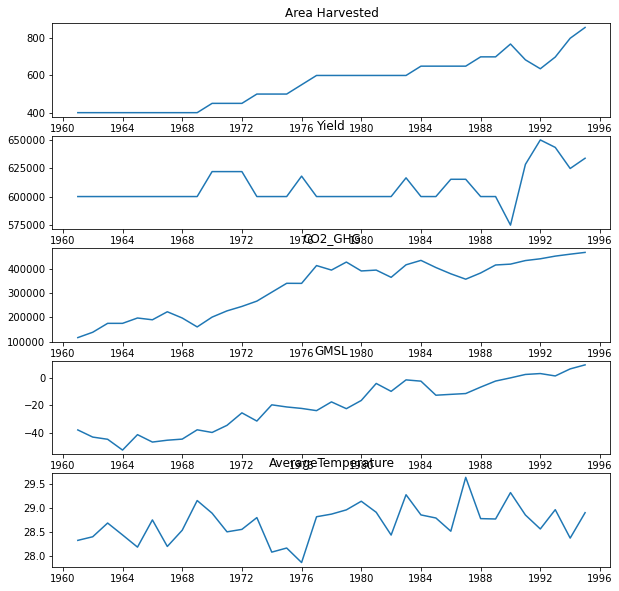

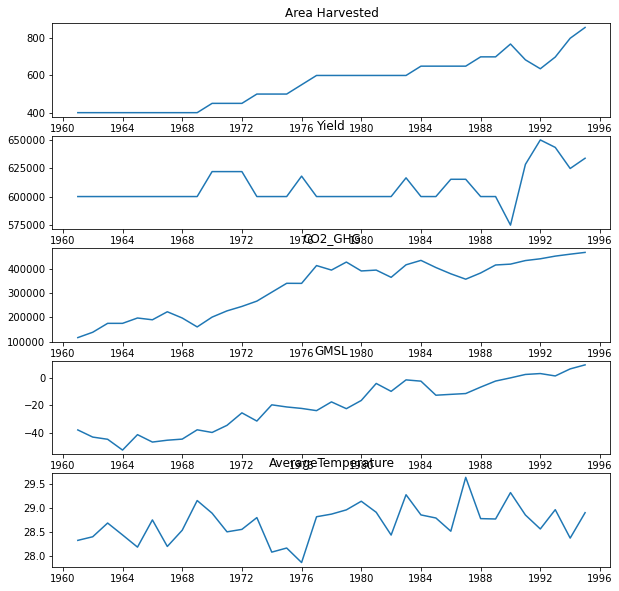

In [124]:
results.plot()

Residual plots do seem to have trends, its not just noise. But I did expect this as well. The input is not as robust as it could be. 

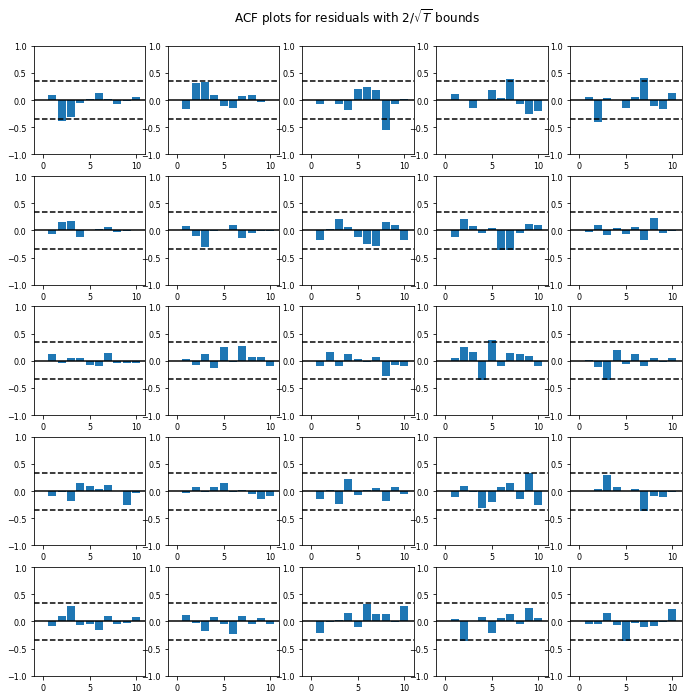

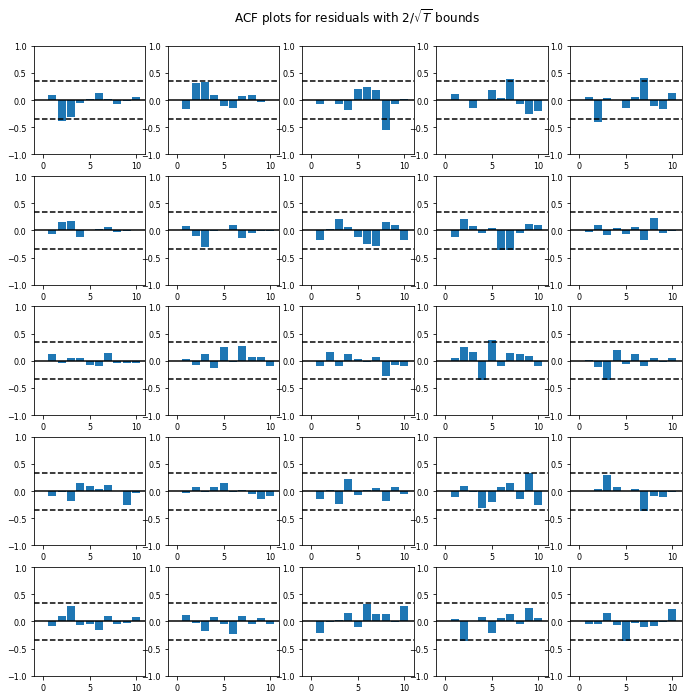

In [125]:
results.plot_acorr()

All co-relation plots seem to have points of statistic significance as well as negative co-relations. I think it's safe to say that I'm going to just pick lag 1 and do the forecasting with it. 

In [126]:
pred = results.forecast(banana_train.values, steps=len(banana_test))

df_forecast = pd.DataFrame(pred, index=banana_test.index, columns=banana.columns) 
df_forecast

,Area Harvested,Yield,CO2_GHG,GMSL,AverageTemperature
Year,,,,,
1996-01-01,891.227539,635948.292468,4.955678e+05,17.670460,29.123582
1997-01-01,928.624401,638237.713626,5.247055e+05,24.495576,29.149493
1998-01-01,969.724046,640843.150560,5.552234e+05,30.580391,29.184244
1999-01-01,1014.027889,643610.590934,5.864372e+05,36.624414,29.230147
2000-01-01,1061.308952,646599.294063,6.183805e+05,42.892290,29.282545
2001-01-01,1111.620067,649870.950960,6.513296e+05,49.485161,29.339498
2002-01-01,1165.166001,653458.853747,6.855993e+05,56.457982,29.400540
2003-01-01,1222.218211,657379.987168,7.214903e+05,63.855362,29.465767
2004-01-01,1283.077268,661646.254111,7.592836e+05,71.720706,29.535457


In [127]:
fig = go.Figure()

# Yield - orig and forecast
fig.add_trace(go.Scatter(x=country_df['Mali'].index, y=country_df['Mali']['Yield'], mode='lines', name="Original Yield"))
fig.add_trace(go.Scatter(x=df_forecast.index, y=df_forecast["Yield"], mode='lines', name="Forecast Yield", line={'dash': 'dash', 'color': 'blue'}))


fig.update_layout(
    yaxis_title="Banana crop yield: Mali", 
    xaxis_title="Year",
    legend_title="", 
    title="Forecast of the Banana crop yield for Mali"
)
fig.show()

The forecast predicts an upward trend of the yield, as in our first model. All the same explanations hold good here too. Higher emissions values are actually good for more robust growth of the plants. And the model only has this one significant parameter to forecast on. So the fact that its trending upwards makes sense. 

The original graph is perfectly depicting the journey of the banana crop in Mali. In 2004, there was unfavorable weather and in 2008, the crops in Africa were hit by the Tropical Race 4 fungus that destroyed most of the banana plantations. Those two steep dips are explained by these phenomenon.  

### Costa Rica

In [128]:
country_df['Costa Rica'].shape

(53, 5)

In [129]:
# train-test split
banana2_train = country_df['Costa Rica'].loc[country_df['Costa Rica'].index <= '1995-01-01', :]
banana2_test = country_df['Costa Rica'].loc[country_df['Costa Rica'].index > '1995-01-01', :]
banana2 = country_df['Costa Rica']

In [130]:
model2 = VAR(banana2_train)
results2 = model2.fit(maxlags=1)
results2.summary()

C:\Users\The PRO\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:524: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.



  Summary of Regression Results   
Model:                         VAR
Method:                        OLS
Date:           Sun, 05, Dec, 2021
Time:                     14:51:56
--------------------------------------------------------------------
No. of Equations:         5.00000    BIC:                    65.1429
Nobs:                     34.0000    HQIC:                   64.2554
Log likelihood:          -1295.75    FPE:                5.18072e+27
AIC:                      63.7961    Det(Omega_mle):     2.29871e+27
--------------------------------------------------------------------
Results for equation Area Harvested
                           coefficient       std. error           t-stat            prob
----------------------------------------------------------------------------------------
const                     33261.874452     76739.236707            0.433           0.665
L1.Area Harvested             1.016636         0.148707            6.837           0.000
L1.Yield           

The AIC value on this model is higher than Mali but lower than our total yield model. 

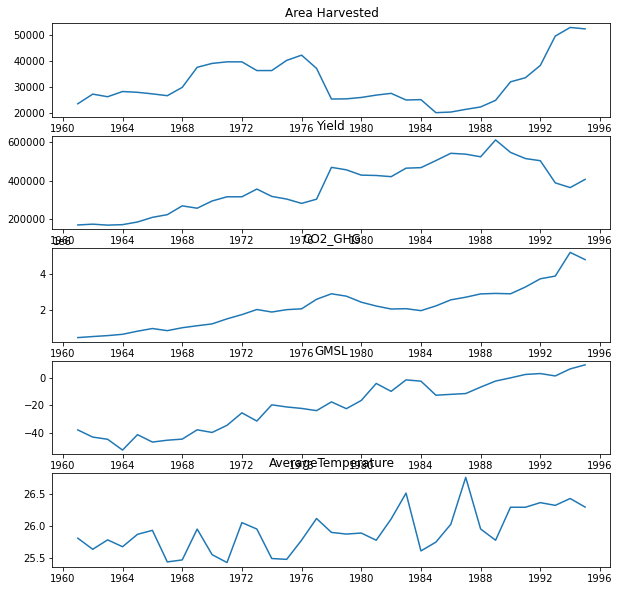

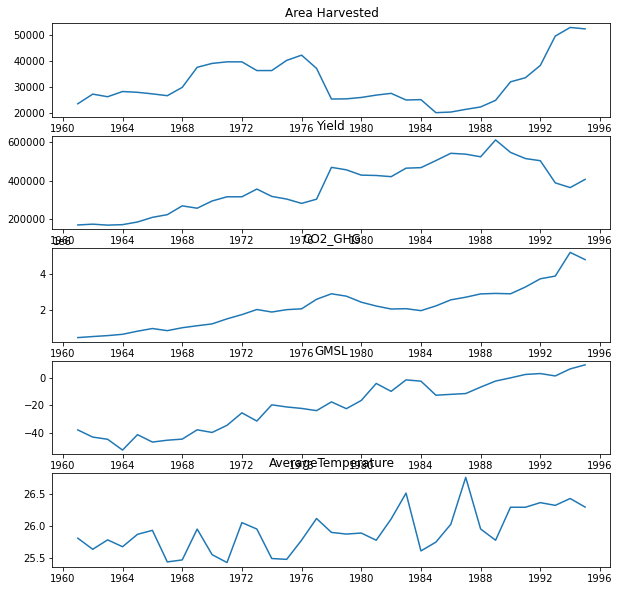

In [131]:
results2.plot()

Similar to the previous model, most of these also exhibit some kind of trends, it doesn't look to be only noise. 

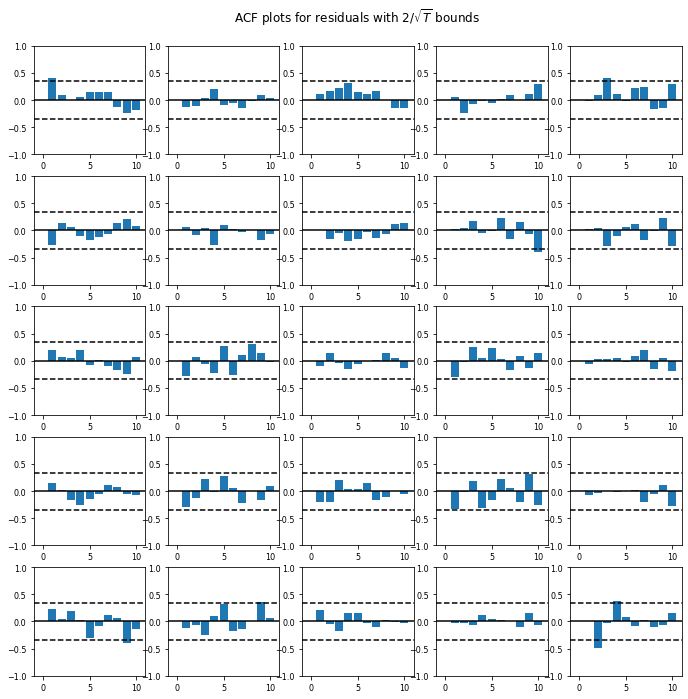

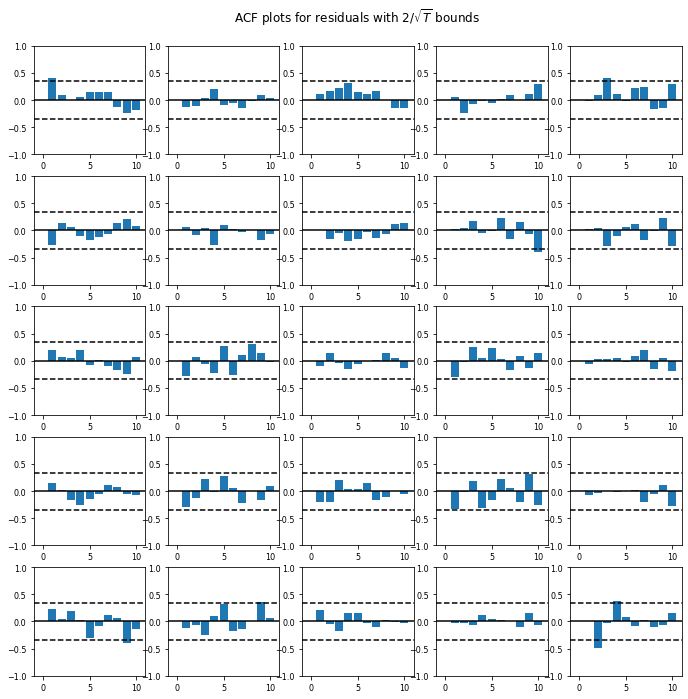

In [132]:
results2.plot_acorr()

These co-relation plots seem to exhibit a similar mix of statistically significant points and negative co-relations as the previous model. We're going to go with lag 1 here too. 

In [133]:
pred2 = results2.forecast(banana2_train.values, steps=len(banana2_test))

df2_forecast = pd.DataFrame(pred2, index=banana2_test.index, columns=banana2.columns) 
df2_forecast

,Area Harvested,Yield,CO2_GHG,GMSL,AverageTemperature
Year,,,,,
1996-01-01,52439.628200,419071.143661,5.056281e+06,11.554089,26.329595
1997-01-01,52769.598248,432257.550136,5.282311e+06,14.068884,26.365261
1998-01-01,53143.962710,445810.541970,5.492292e+06,16.789267,26.401106
1999-01-01,53556.659859,459414.689650,5.693093e+06,19.587966,26.436737
2000-01-01,54004.603238,472892.344074,5.888539e+06,22.406463,26.472009
2001-01-01,54485.729556,486147.236657,6.080849e+06,25.218756,26.506899
2002-01-01,54998.227377,499132.069815,6.271366e+06,28.014254,26.541438
2003-01-01,55540.287523,511829.351656,6.460936e+06,30.789651,26.575671
2004-01-01,56110.060128,524239.708286,6.650110e+06,33.545040,26.609648


In [134]:
fig2 = go.Figure()

# Yield - orig and forecast
fig2.add_trace(go.Scatter(x=country_df['Costa Rica'].index, y=country_df['Costa Rica']['Yield'], mode='lines', name="Original Yield", line={'color': 'orange'}))
fig2.add_trace(go.Scatter(x=df2_forecast.index, y=df2_forecast["Yield"], mode='lines', name="Forecast Yield", line={'dash': 'dash', 'color': 'orange'}))


fig2.update_layout(
    yaxis_title="Banana crop yield: Costa Rica", 
    xaxis_title="Year",
    legend_title="", 
    title="Forecast of the Banana crop yield for Costa Rica"
)
fig2.show()

The forecast, as usual, seems to be trending upwards. The same intuition applies. The model only has enough input to predict an upwards trend. 

The original yield graph tells the story of the journey of the banana crop in Costa Rica. I have explained this using Costa Rica as my use case above in the EDA section. The sharp downward spikes account for plantations being affected by the various environmental and labour court cases that are pending. And some others like in the case of 2009 account for unfavorable weather. 

### Honduras

In [135]:
country_df['Honduras'].shape

(53, 5)

In [136]:
# train-test split
banana3_train = country_df['Honduras'].loc[country_df['Honduras'].index <= '1995-01-01', :]
banana3_test = country_df['Honduras'].loc[country_df['Honduras'].index > '1995-01-01', :]
banana3 = country_df['Honduras']

In [137]:
model3 = VAR(banana3_train)
results3 = model3.fit(maxlags=1)
results3.summary()

C:\Users\The PRO\anaconda3\lib\site-packages\statsmodels\tsa\base\tsa_model.py:524: ValueWarning:

No frequency information was provided, so inferred frequency AS-JAN will be used.



  Summary of Regression Results   
Model:                         VAR
Method:                        OLS
Date:           Sun, 05, Dec, 2021
Time:                     14:52:01
--------------------------------------------------------------------
No. of Equations:         5.00000    BIC:                    64.5824
Nobs:                     34.0000    HQIC:                   63.6949
Log likelihood:          -1286.22    FPE:                2.95783e+27
AIC:                      63.2356    Det(Omega_mle):     1.31240e+27
--------------------------------------------------------------------
Results for equation Area Harvested
                           coefficient       std. error           t-stat            prob
----------------------------------------------------------------------------------------
const                    186605.979374     76592.781274            2.436           0.015
L1.Area Harvested             0.777454         0.090955            8.548           0.000
L1.Yield           

This one's AIC is a little better than the second model! 

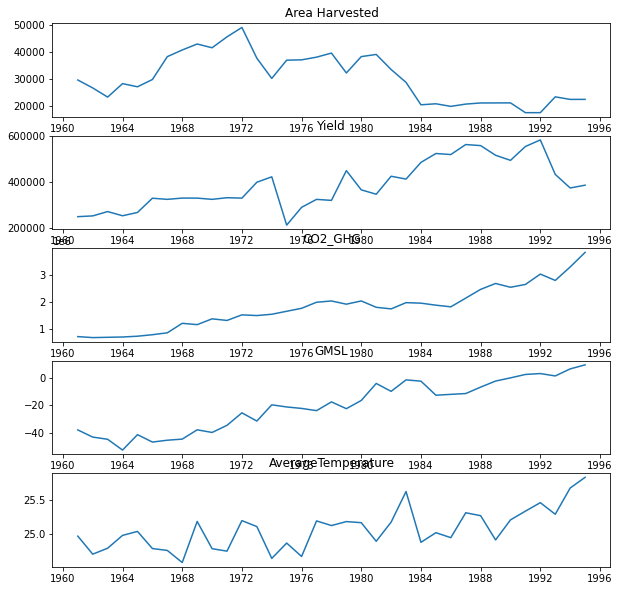

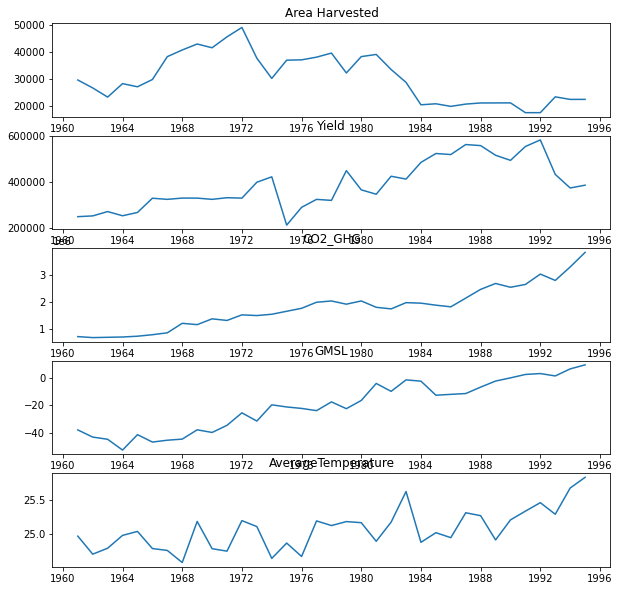

In [138]:
results3.plot()

As the above models, we did not expect anything too different, this one also exhibits trends in the residuals. 

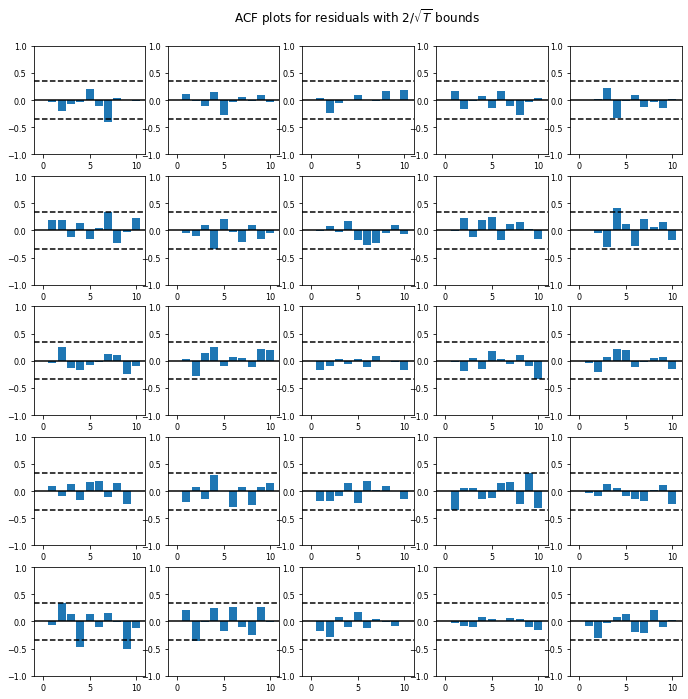

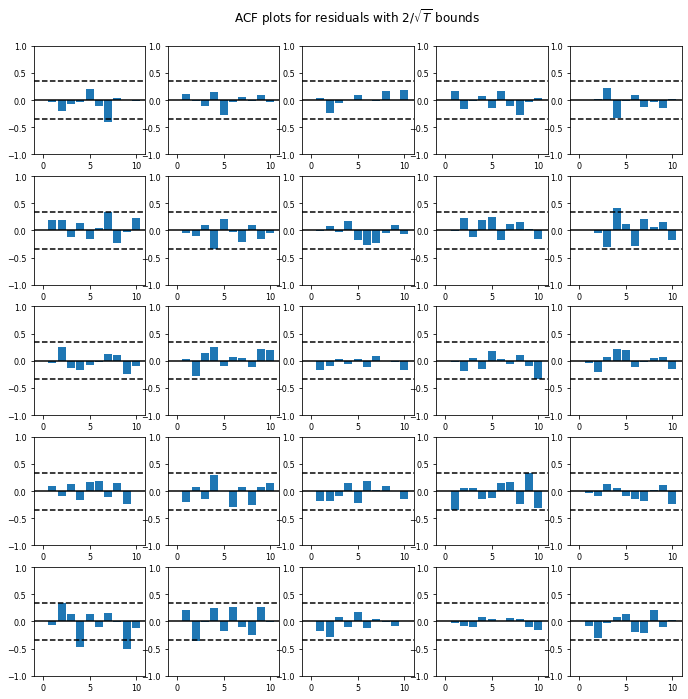

In [139]:
results3.plot_acorr()

Nothing new to report here. We are going to stay consistent and pick lag 1.

In [140]:
pred3 = results3.forecast(banana3_train.values, steps=len(banana3_test))

df3_forecast = pd.DataFrame(pred3, index=banana3_test.index, columns=banana3.columns) 
df3_forecast

,Area Harvested,Yield,CO2_GHG,GMSL,AverageTemperature
Year,,,,,
1996-01-01,22347.054163,391193.645489,4.134435e+06,17.011206,25.775453
1997-01-01,22561.632244,395561.430264,4.445173e+06,23.901284,25.877624
1998-01-01,21910.548657,406225.373970,4.774800e+06,31.008962,25.976462
1999-01-01,20712.595598,419825.642946,5.126197e+06,38.390288,26.081379
2000-01-01,19122.106289,434780.358376,5.502711e+06,46.110134,26.193795
2001-01-01,17240.852976,450198.213320,5.907688e+06,54.230130,26.315077
2002-01-01,15135.298785,465608.353595,6.344542e+06,62.816413,26.446413
2003-01-01,12847.464950,480801.032878,6.816784e+06,71.941147,26.588927
2004-01-01,10401.268161,495734.803111,7.328049e+06,81.682264,26.743723


In [141]:
fig3 = go.Figure()

# Yield - orig and forecast
fig3.add_trace(go.Scatter(x=country_df['Honduras'].index, y=country_df['Honduras']['Yield'], mode='lines', name="Original Yield", line={'color': 'green'}))
fig3.add_trace(go.Scatter(x=df3_forecast.index, y=df3_forecast["Yield"], mode='lines', name="Forecast Yield", line={'dash': 'dash', 'color': 'green'}))


fig3.update_layout(
    yaxis_title="Banana crop yield: Honduras", 
    xaxis_title="Year",
    legend_title="", 
    title="Forecast of the Banana crop yield for Honduras"
)
fig3.show()

The forecast is as always trending upwards. Nothing new to add. The input is insuffcient for it to be able to do any better. 

Honduras, as the other South American Banana producing countries were a part of the 'Banana Wars'. These lasted a good many years. As a consequence, many years in the interim, the Banana crop would suffer due to labour or environmental court cases against plantations and plantation owners. These downward dips account for some events like these. 

### Step 10 : Insights and Conclusions 

Let's quickly summarise some key learnings : 

- The input data is insufficient. The model would learn better with the help of additional environmental inputs like precipitation, humidity, macroecomic inputs like wages and the employment index and others like disease data. Most of these data sets will not be readily available for our use. 
- The logistic regression models and the time series model support the other's results. The models point towards the Banana not going extinct for the next three decades at least, as the yield tends upwards. 

|      **Model**      | **Test Score** |
|---------------------|----------------|
| Logistic Regression |      0.54      |
|  (Baseline model)   |                |
|                     |                |
| "Best" Logistic Reg |      0.55      |
| (5-fold cross val)  |                |


|      **Model**      | **AIC Scores** |
|---------------------|----------------|
| Time Series model   |     549.48     |
|  (Total Yield)      |                |
|                     |                |
| Time Series Model   |     47.75      |
|      (Mali)         |                |
|                     |                |
| Time Series Model   |     63.79      |
|   (Costa Rica)      |                |
|                     |                |
| Time Series Model   |     63.23      |
|    (Honduras)       |                |


- No model is very accurate because the only parameter they're using as statistically significant is emissions and higher carbon-dioxide in the air is good for plant growth and the model is hence predicting upward trends for Yield. 
- Emissions is closely co-related with Yield (with a p value <0.05). And this leads me to believe that other factors like precipitation and humidity will also be closely co-related. 
- My intuition for the sharp downward trends in Yields in the country specific forecasts is that its not due to one factor. Each spike can be explained differently. Bananas have a very dark colonial past; the industry was built on the back of slavery. Even to this day, the banana production is affected by outstanding labor and environmental law suits against the giants that monopolise the banana crop market, like Monsanto, for example. These events are referred to as Banana wars in Central America. 
- Sharp downward spikes can also be explained by isolated events like unfavorable weather or disease outbreaks. For example, in the model for Mali, the downward dip in Yield for 2008, can be explained by the fact that there was a fungal disease outbreak in Africa that year. The fungus was called Tropical Race 4 and decimated large cultivations of the banana crop. An example of unfavorable weather is 2009, in Honduras, when croplands were destroyed due to floods.  

What are going to be some of my next steps regarding this project? 

- The next steps for this project would involve collecting more input for the model, as mentioned previously. 
- Then I would need to make a decision about how these parameters would need to look for this particular use-case, for example disease data, what would it need to look like to be incorporated here? 
- Once I decide the new features and then collect the data, I could then potentially fine tune the models for better accuracy. 

### END. 